<a href="https://colab.research.google.com/github/mayank2705/Mathematics_answer_sheet_checking_system/blob/main/Copy_of_Final_Mathematics_Answer_Sheets_Checking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install tensorflow-gpu==1.15.3
!pip install --no-deps keras==2.2.4
from google.colab import output
output.clear()

In [2]:
#Loading libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
from scipy import ndimage
import math
import keras
import ast
import operator as op
import re
from tensorflow.keras.preprocessing.image import ImageDataGenerator
#Suppressing warning
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn
from google.colab.patches import cv2_imshow
from google.colab import output

Using TensorFlow backend.


In [3]:
import tensorflow as tf
print(tf.__version__)



1.15.3


In [4]:
%cd 
!git clone https://github.com/matterport/Mask_RCNN.git

%cd ~/Mask_RCNN/
!pip install PyDrive
!pip install -r requirements.txt
!python setup.py install 
output.clear()

In [5]:
!pip show mask_rcnn

Name: mask-rcnn
Version: 2.1
Summary: Mask R-CNN for object detection and instance segmentation
Home-page: https://github.com/matterport/Mask_RCNN
Author: Matterport
Author-email: waleed.abdulla@gmail.com
License: MIT
Location: /usr/local/lib/python3.6/dist-packages/mask_rcnn-2.1-py3.6.egg
Requires: 
Required-by: 


In [6]:

  
from tensorflow.keras.layers import Input, concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.layers import Convolution2D,MaxPooling2D
from keras import optimizers



def model_train(solution_list):
  classes2 = get_class(solution_list)
  #classes2 += ['rej']
  train_datagen = ImageDataGenerator(
      #data_format='channels_first',
      rescale = 1/255,
      validation_split=0.2)

  train_batches = train_datagen.flow_from_directory(
      '/root/content/content/RCNN_images/',
      target_size = (28,28),
      color_mode = 'grayscale',
      batch_size = 20,
      shuffle=False,
      classes = classes2,
      class_mode = 'categorical',
      subset = 'training'
  )
  valid_batches = train_datagen.flow_from_directory(
      '/root/content/content/RCNN_images/',
      target_size=(28,28),
      color_mode = 'grayscale',
      batch_size=20,
      shuffle=False,
      classes= classes2,
      class_mode = 'categorical',
      subset='validation'
  )

  print(classes2)
  no_of_c = len(classes2)
  classes_dict = valid_batches.class_indices

  print(classes_dict)
  
  img_rows, img_cols = 28,28

  nb_filters_1 = 64
  nb_filters_2 = 128
  nb_filters_3 = 256
  nb_conv = 3
  nb_conv_mid = 4
  nb_conv_init = 5

  init = Input(shape=(28,28,1),)

  fork11 = Convolution2D(nb_filters_1, nb_conv_init, nb_conv_init,  activation="relu", padding='same')(init)
  fork12 = Convolution2D(nb_filters_1, nb_conv_init, nb_conv_init, activation="relu", padding='same')(init)
  merge1 = concatenate([fork11, fork12], axis=1, name='merge1')
  #concat_feat = concatenate([concat_feat, x], mode='concat', axis=concat_axis, name='concat_'+str(stage)+'_'+str(branch))
  maxpool1 = MaxPooling2D(strides=(2,2), padding='same')(merge1)

  fork21 = Convolution2D(nb_filters_2, nb_conv_mid, nb_conv_mid, activation="relu", padding='same')(maxpool1)
  fork22 = Convolution2D(nb_filters_2, nb_conv_mid, nb_conv_mid, activation="relu", padding='same')(maxpool1)
  merge2 = concatenate([fork21, fork22, ], axis=1, name='merge2')
  maxpool2 = MaxPooling2D(strides=(2,2), padding='same')(merge2)

  fork31 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
  fork32 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
  fork33 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
  fork34 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
  fork35 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
  fork36 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
  merge3 = concatenate([fork31, fork32, fork33, fork34, fork35, fork36, ], axis=1, name='merge3')
  maxpool3 = MaxPooling2D(strides=(2,2), padding='same')(merge3)

  dropout = Dropout(0.5)(maxpool3)

  flatten = Flatten()(dropout)
  output = Dense(no_of_c, activation="softmax")(flatten)

  model2 = Model(inputs=init, outputs=output)

  model2.summary()
  from keras import optimizers
  ada = tensorflow.keras.optimizers.Adadelta(lr=1.0,rho=0.95)
  model2.compile(optimizer=ada,
              loss='categorical_crossentropy',
              metrics=['accuracy'])
  history = model2.fit_generator(train_batches,
                              validation_data=valid_batches,
                              steps_per_epoch=100,
                              validation_steps=100,
                              epochs=3)
  
  return model2,classes_dict







In [7]:
def get_key1(val,dict2): 
    for key, value in dict2.items(): 
         if val == value: 
             return key 

In [8]:
def get_class(solution_list):
  class1 = set(solution_list)
  list2 = list(class1)
  return list2

In [9]:
def predict(row1,solution_list): 
  resultant_list = []
  model2,class_dict = model_train(solution_list)
  for i in row1:
    plt.imshow(i)
    plt.show()
    img = np.expand_dims(i,axis=0)
    img = img.reshape(1,28,28,1)
    img = img/255
    y_prob = model2.predict(img)
    #y_classes1 = keras.utils.np_utils.probas_to_classes(y_prob)
    #print(y_classes1)
    y_classes = y_prob.argmax(axis=1)
    key = get_key1(y_classes[0],class_dict)
    print(key)
    resultant_list.append(key)
    print(resultant_list)
  return resultant_list   

In [10]:
img_rows, img_cols = 28,28

nb_filters_1 = 64
nb_filters_2 = 128
nb_filters_3 = 256
nb_conv = 3
nb_conv_mid = 4
nb_conv_init = 5

init = Input(shape=(28,28,1),)

fork11 = Convolution2D(nb_filters_1, nb_conv_init, nb_conv_init,  activation="relu", padding='same')(init)
fork12 = Convolution2D(nb_filters_1, nb_conv_init, nb_conv_init, activation="relu", padding='same')(init)
merge1 = concatenate([fork11, fork12], axis=1, name='merge1')
  #concat_feat = concatenate([concat_feat, x], mode='concat', axis=concat_axis, name='concat_'+str(stage)+'_'+str(branch))
maxpool1 = MaxPooling2D(strides=(2,2), padding='same')(merge1)
fork21 = Convolution2D(nb_filters_2, nb_conv_mid, nb_conv_mid, activation="relu", padding='same')(maxpool1)
fork22 = Convolution2D(nb_filters_2, nb_conv_mid, nb_conv_mid, activation="relu", padding='same')(maxpool1)
merge2 = concatenate([fork21, fork22, ], axis=1, name='merge2')
maxpool2 = MaxPooling2D(strides=(2,2), padding='same')(merge2)

fork31 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
fork32 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
fork33 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
fork34 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
fork35 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
fork36 = Convolution2D(nb_filters_3, nb_conv, nb_conv, activation="relu", padding='same')(maxpool2)
merge3 = concatenate([fork31, fork32, fork33, fork34, fork35, fork36, ], axis=1, name='merge3')
maxpool3 = MaxPooling2D(strides=(2,2), padding='same')(merge3)

dropout = Dropout(0.5)(maxpool3)

flatten = Flatten()(dropout)
output = Dense(21, activation="softmax")(flatten)

model_1 = Model(inputs=init, outputs=output)
model_2 = Model(inputs = init,outputs = output)


model_1.load_weights('/content/drive/My Drive/301020_digits.h5') 
model_2.load_weights('/content/drive/My Drive/29012021_digits.h5')


Instructions for updating:
If using Keras pass *_constraint arguments to layers.


In [11]:
def predict_using_model(row1,solution_list): 
  resultant_list = []
  class_dict = {'0': 0, '1': 1, '2': 2, '3': 3, '4': 4, '5': 5, '6': 6, '7': 7, '8': 8, '9': 9, 'A': 10, 'b': 11, 'C': 12, 'X': 13, 'y': 14, 'z': 15, '(': 16, ')': 17, '+': 18, '-': 19, 'times': 20}
  for i in row1:
    plt.imshow(i)
    plt.show()
    img = np.expand_dims(i,axis=0)
    img = img.reshape(1,28,28,1)
    img = img/255
    y_prob = model_new.predict(img)
    #y_classes1 = keras.utils.np_utils.probas_to_classes(y_prob)
    #print(y_classes1)
    y_classes = y_prob.argmax(axis=1)
    key = get_key1(y_classes[0],class_dict)
    print(key)
    resultant_list.append(key)
    print(resultant_list)
  print("RESULTANT")  
  ' '.join(resultant_list)
  print("ORIGINAL_SOLUTION")
  print(solution_list)
  return resultant_list  

In [12]:
def sort_contours(cnts, method="left-to-right"):
    '''
    sort_contours : Function to sort contours
    argument:
        cnts (array): image contours
        method(string) : sorting direction
    output:
        cnts(list): sorted contours
        boundingBoxes(list): bounding boxes
    '''
    # initialize the reverse flag and sort index
    reverse = False
    i = 0

    # handle if we need to sort in reverse
    if method == "right-to-left" or method == "bottom-to-top":
        reverse = True

    # handle if we are sorting against the y-coordinate rather than
    # the x-coordinate of the bounding box
    if method == "top-to-bottom" or method == "bottom-to-top":
        i = 1

    # construct the list of bounding boxes and sort them from top to
    # bottom
    boundingBoxes = [cv2.boundingRect(c) for c in cnts]
    (cnts, boundingBoxes) = zip(*sorted(zip(cnts, boundingBoxes),
        key=lambda b:b[1][i], reverse=reverse))

    # return the list of sorted contours and bounding boxes
    return (cnts, boundingBoxes)

In [13]:
def getBestShift(img):
    '''
    getBestShift : Function to calculate centre of mass and get the best shifts
    argument:
        img (array) : gray scale image
    output:
        shiftx, shifty: x,y shift direction
    '''
    cy,cx = ndimage.measurements.center_of_mass(img)
    rows,cols = img.shape
    shiftx = np.round(cols/2.0-cx).astype(int)
    shifty = np.round(rows/2.0-cy).astype(int)

    return shiftx,shifty


def shift(img,sx,sy):
    '''
    Shift : Function to shift the image in given direction 
    argument:
        img (array) : gray scale image
        sx, sy      : x, y direction
    output:
        shifted : shifted image
    '''
    rows,cols = img.shape
    M = np.float32([[1,0,sx],[0,1,sy]])
    shifted = cv2.warpAffine(img,M,(cols,rows))
    return shifted

def process_img (gray, resize_flag = 1, preproc = 0):
    '''
    process_img  : Function to pre process image for prediction
    argument:
        gray (Matrix (np.uint8))  : image of character to be resized and processed
        resize_flag               : method used for resizing image
        preproc (method [bool])   : 0 : No erosion DIlation, 1 : Erosion, Dilation
    output:
        grayS (Matrix (0-1))      : Normalised image of character resized and processed
    
    '''    
    gray = gray.copy()
    
    #Image Pre Processing
    """if (preproc == 0):
        gray = cv2.GaussianBlur(gray,(7,7),0)
    else :
        kernel = np.ones((3,3), np.uint8)
        gray = cv2.dilate(gray, kernel, iterations=1)    
        gray = cv2.GaussianBlur(gray,(5,5),1)
        gray = cv2.dilate(gray, kernel, iterations=2)
        gray = cv2.erode(gray, kernel,iterations=2)"""    
    
    #Removing rows and columns where all the pixels are black
    """while np.sum(gray[0]) == 0:
        gray = gray[1:]

    while np.sum(gray[:,0]) == 0:
        gray = np.delete(gray,0,1)

    while np.sum(gray[-1]) == 0:
        gray = gray[:-1]

    while np.sum(gray[:,-1]) == 0:
        gray = np.delete(gray,-1,1)"""

    rows,cols = gray.shape
    
    if(resize_flag) == 1:
        interpolation=cv2.INTER_AREA
    else:
        interpolation=cv2.INTER_CUBIC
    # Making the aspect ratio same before re-sizing
    if rows > cols:
        factor = 20.0/rows
        rows = 20
        cols = int(round(cols*factor))
        # first cols than rows
        gray = cv2.resize(gray, (cols,rows),interpolation=interpolation)
    else:
        factor = 20.0/cols
        cols = 20
        rows = int(round(rows*factor))
        # first cols than rows
        gray = cv2.resize(gray, (cols, rows),interpolation=interpolation)
   
    # Padding to a 28 * 28 image
    colsPadding = (int(math.ceil((28-cols)/2.0)),int(math.floor((28-cols)/2.0)))
    rowsPadding = (int(math.ceil((28-rows)/2.0)),int(math.floor((28-rows)/2.0)))
    gray = np.lib.pad(gray,(rowsPadding,colsPadding),'constant')
    
    # Get the best shifts
    shiftx,shifty = getBestShift(gray)
    shifted = shift(gray,shiftx,shifty)
    kernel = np.ones((3,3), np.uint8)
    #print(shifted.shape)
    #shifted_gray = cv2.cvtColor(shifted,cv2.COLOR_BGR2GRAY)
    #new = cv2.resize(shifted,(45,45))
    return shifted

In [14]:
# evaluate the mask rcnn model on the kangaroo dataset
from os import listdir
from xml.etree import ElementTree
from numpy import zeros
from numpy import asarray
from numpy import expand_dims
from numpy import mean
from mrcnn.config import Config
from mrcnn.model import MaskRCNN
from mrcnn.utils import Dataset
from mrcnn.utils import compute_ap
from mrcnn.model import load_image_gt
from mrcnn.model import mold_image

In [15]:
class PredictionConfig(Config):
	# define the name of the configuration
	NAME = "equations_cfg"
	# number of classes (background + kangaroo)
	NUM_CLASSES = 1 + 1
	# simplify GPU config
	GPU_COUNT = 1
	IMAGES_PER_GPU = 1

In [16]:
cfg = PredictionConfig()
# Create model object in inference mode.
model = MaskRCNN(mode="inference", model_dir='/content/drive/My Drive/RCNN_Colored_model', config=cfg)

# Load weights trained on MS-COCO
model.load_weights('/content/drive/My Drive/RCNN_Colored_model/mask_rcnn_equations_colored_cfg_0005.h5', by_name=True)
from google.colab import output
output.clear()

In [17]:
def word_division(lines,choice):
  W2_eqs = []
  for i in lines:
    grey = cv2.cvtColor(i.copy(),cv2.COLOR_BGR2GRAY)
    _,binary = cv2.threshold(grey,127,255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    gray = binary.copy()
    """if (choice==1):
      kernel = np.ones((2,2), np.uint8)
      gray = cv2.dilate(binary, kernel, iterations=1)
    else:
      gray = binary.copy()"""
    contours,heirarchy = cv2.findContours(gray.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours,bounding_boxes = sort_contours(contours,method='left-to-right')
    cont = gray.copy()
    eqs = []
    for c in contours:
      x,y,w,h = cv2.boundingRect(c)
      cv2.rectangle(cont,(x,y),(x+w,y+h),(255,0,0),1)
      digit = gray[y:y+h,x:x+w].copy()
      if choice == 1:
        kernel = np.ones((2,2), np.uint8)
        dilation = cv2.dilate(digit,kernel,iterations = 1)
      else:
        dilation = digit  
      new_digit = process_img(dilation)
      if w > 5 or h > 5:
        cv2_imshow(new_digit)
        eqs.append(new_digit)
        #print("x = ",x," y = ",y," w = ",w," h = ",h)
    cv2_imshow(gray)
    W2_eqs.append(eqs)
  return W2_eqs

In [18]:
def RCNN_inference(sheet):
  workspace1 = sheet.copy()
  scaled_image = mold_image(workspace1, cfg)
		# convert image into one sample
  sample = expand_dims(scaled_image, 0)
		# make prediction
  yhat = model.detect(sample, verbose=0)[0]
  new_rois = []
  for box in yhat['rois']:
    x = box.tolist()
    new_rois.append(x)
  new_rois = sorted(new_rois, key=lambda roi: roi[0]) 
  for count,box in enumerate(new_rois):
    y1,x1,y2,x2 = box
    print(count," y1 = ",y1," x1 = ",x1," y2 = ",y2," x2 = ",x2)
    cv2.rectangle(workspace1,(x1,y1),(x2,y2),(255,0,0), 2)
    cv2.putText(workspace1, str(count), (x1,y1),cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2)
  cv2_imshow(workspace1)
  return new_rois 


def show_bb_on_image(rois,workspace):
  for count,box in enumerate(rois):
    y1,x1,y2,x2 = box
    print(count,"y1 = ",y1,"x1 = ",x1,"y2 = ",y2,"x2 = ",x2)
    cv2.rectangle(workspace,(x1-10,y1-10),(x2+10,y2+10),(255,0,0), 2)
    cv2.putText(workspace, str(count), (x1,y1-10),cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2)
  cv2_imshow(workspace)

def Rois_division(workspace,rois):
  W1_rois = []
  W2_rois = [] 
  W3_rois = []

  for box in rois:
    y1,x1,y2,x2 = box
    if y1 < 680:
      W1_rois.append(box)
    elif y1 > 680 and y1 < 1350:
      W2_rois.append(box)
    else:
      W3_rois.append(box)
  W1 = workspace.copy()
  W2 = workspace.copy()
  W3 = workspace.copy()  
  show_bb_on_image(W1_rois,W1)
  show_bb_on_image(W2_rois,W2)
  show_bb_on_image(W3_rois,W3)
  return W1_rois,W2_rois,W3_rois


def lines_division(workspace, W1_rois,W2_rois,W3_rois):
  W1_lines = []
  for box in W1_rois:
    y1,x1,y2,x2 = box
    w = x2 - x1
    h = y2 - y1
    if (x1 < 10):
      line = workspace[y1-10:y1+h+10,x1:x1+w+10].copy()
    else:
      line = workspace[y1-10:y1+h+10,x1-10:x1+w+10].copy()
    W1_lines.append(line)
  W2_lines = []
  for box in W2_rois:
    y1,x1,y2,x2 = box
    w = x2 - x1
    h = y2 - y1
    if (x1 < 10):
      line = workspace[y1-10:y1+h+10,x1:x1+w+10].copy()
    else:
      line = workspace[y1-10:y1+h+10,x1-10:x1+w+10].copy()
    W2_lines.append(line)  
  W3_lines = []
  for box in W3_rois:
    y1,x1,y2,x2 = box
    w = x2 - x1
    h = y2 - y1
    if (x1 < 10):
      line = workspace[y1-10:y1+h+10,x1:x1+w+10].copy()
    else:
      line = workspace[y1-10:y1+h+10,x1-10:x1+w+10].copy()
    W3_lines.append(line)  


  print("*******W1********")
  for i in W1_lines:
    cv2_imshow(i)
  print("*******W2********")
  for i in W2_lines:
    cv2_imshow(i)
  print("*******W3********")
  for i in W3_lines:
    cv2_imshow(i)  

  return W1_lines,W2_lines,W3_lines



def workspace_recognition(sheet):
  rois = RCNN_inference(sheet)
  w1_rois,w2_rois,w3_rois = Rois_division(sheet, rois)
  w1_lines,w2_lines,w3_lines = lines_division(sheet,w1_rois,w2_rois,w3_rois)
  return w1_lines,w2_lines,w3_lines

In [19]:
def show_images(imgs):
  for i in imgs:
    cv2_imshow(i)

In [20]:
def show_sheet(l):
  works = os.listdir("/content/drive/My Drive/Colored_Sheets_Images/")
  sheet1 = cv2.imread("/content/drive/My Drive/Colored_Sheets_Images/" + works[l])
  print(works[l])
  cv2_imshow(sheet1)
  print(sheet1.shape)
  return sheet1



SH010-1.jpg


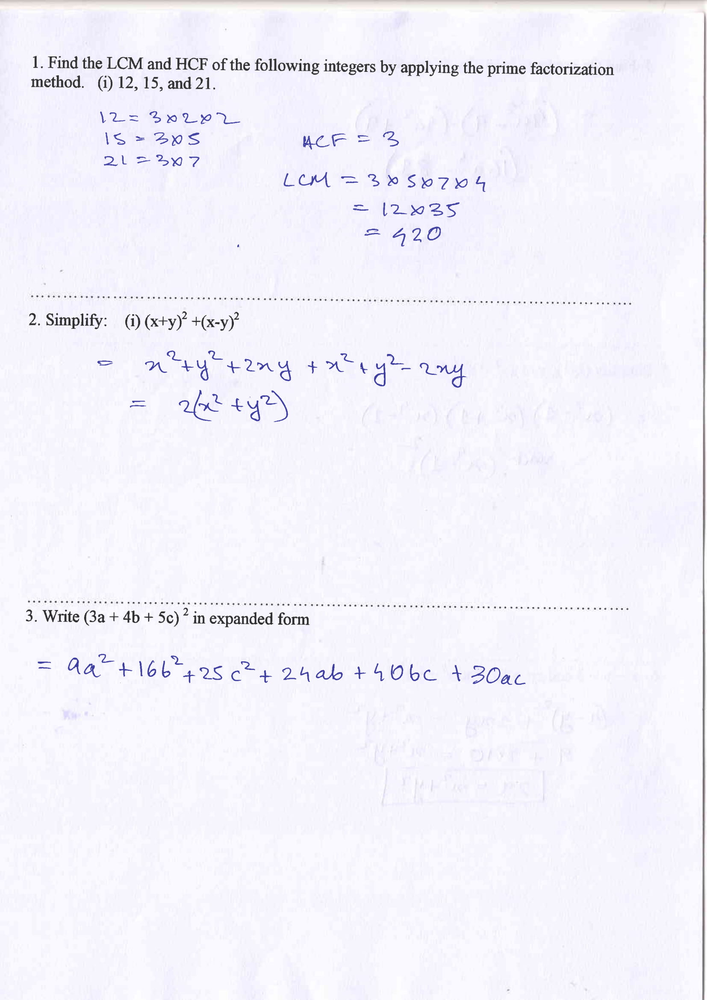

(2339, 1654, 3)


In [21]:
sheet1 = show_sheet(1)

0  y1 =  108  x1 =  9  y2 =  219  x2 =  1429
1  y1 =  247  x1 =  228  y2 =  298  x2 =  555
2  y1 =  288  x1 =  686  y2 =  369  x2 =  948
3  y1 =  299  x1 =  251  y2 =  346  x2 =  494
4  y1 =  346  x1 =  232  y2 =  414  x2 =  479
5  y1 =  384  x1 =  609  y2 =  458  x2 =  1208
6  y1 =  466  x1 =  824  y2 =  515  x2 =  1102
7  y1 =  519  x1 =  821  y2 =  583  x2 =  1054
8  y1 =  715  x1 =  50  y2 =  787  x2 =  618
9  y1 =  815  x1 =  243  y2 =  902  x2 =  1112
10  y1 =  909  x1 =  379  y2 =  1009  x2 =  701
11  y1 =  1415  x1 =  62  y2 =  1480  x2 =  778
12  y1 =  1522  x1 =  0  y2 =  1618  x2 =  1245


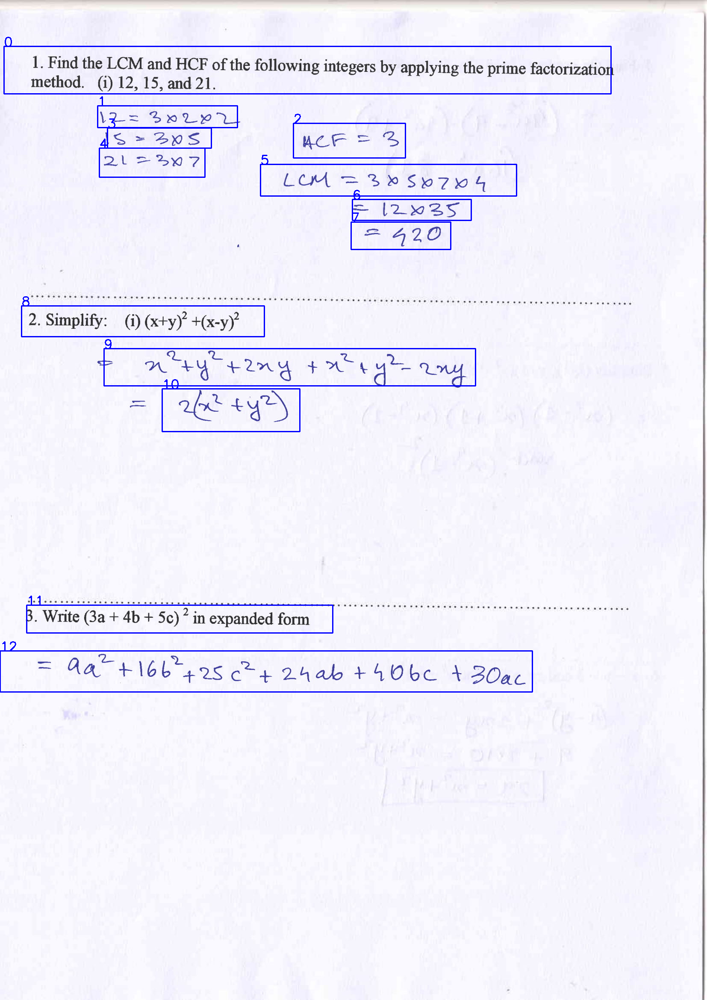

0 y1 =  108 x1 =  9 y2 =  219 x2 =  1429
1 y1 =  247 x1 =  228 y2 =  298 x2 =  555
2 y1 =  288 x1 =  686 y2 =  369 x2 =  948
3 y1 =  299 x1 =  251 y2 =  346 x2 =  494
4 y1 =  346 x1 =  232 y2 =  414 x2 =  479
5 y1 =  384 x1 =  609 y2 =  458 x2 =  1208
6 y1 =  466 x1 =  824 y2 =  515 x2 =  1102
7 y1 =  519 x1 =  821 y2 =  583 x2 =  1054


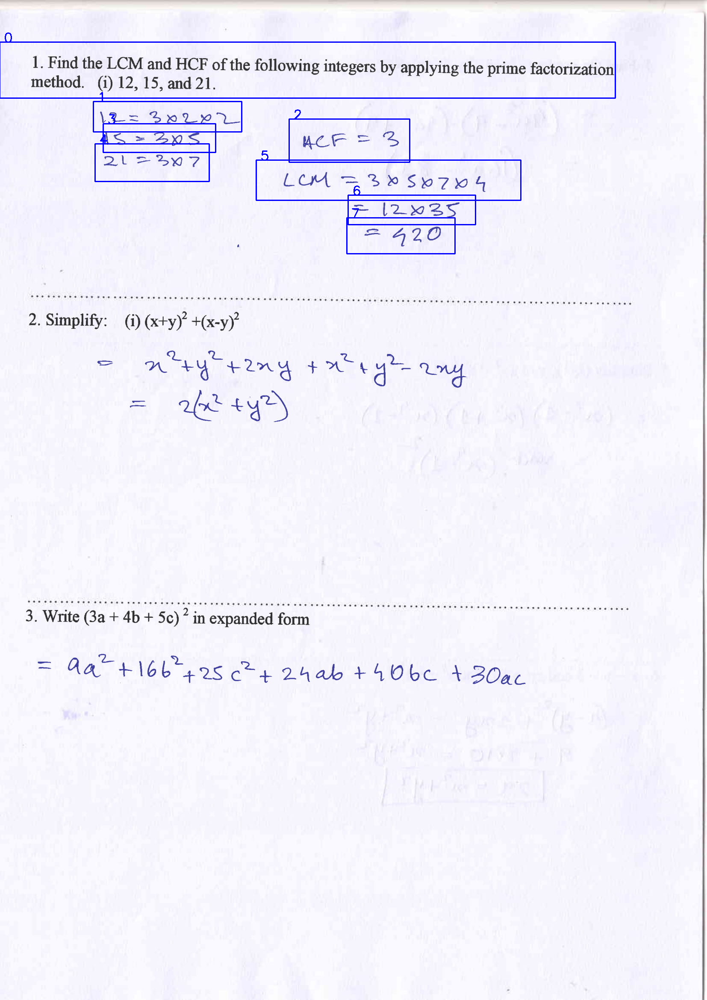

0 y1 =  715 x1 =  50 y2 =  787 x2 =  618
1 y1 =  815 x1 =  243 y2 =  902 x2 =  1112
2 y1 =  909 x1 =  379 y2 =  1009 x2 =  701


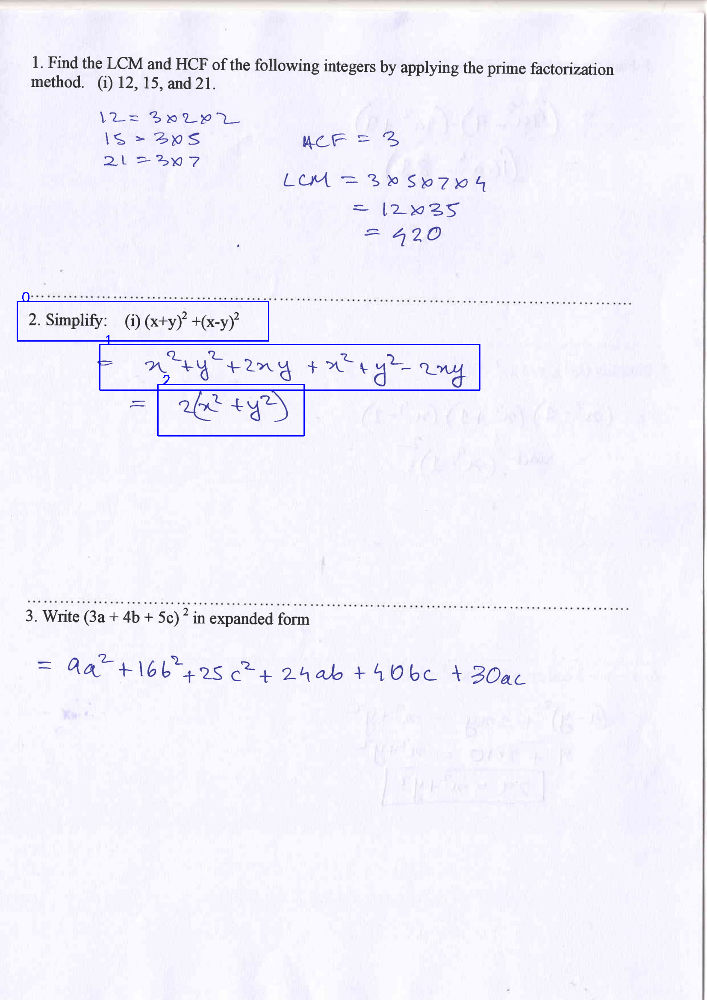

0 y1 =  1415 x1 =  62 y2 =  1480 x2 =  778
1 y1 =  1522 x1 =  0 y2 =  1618 x2 =  1245


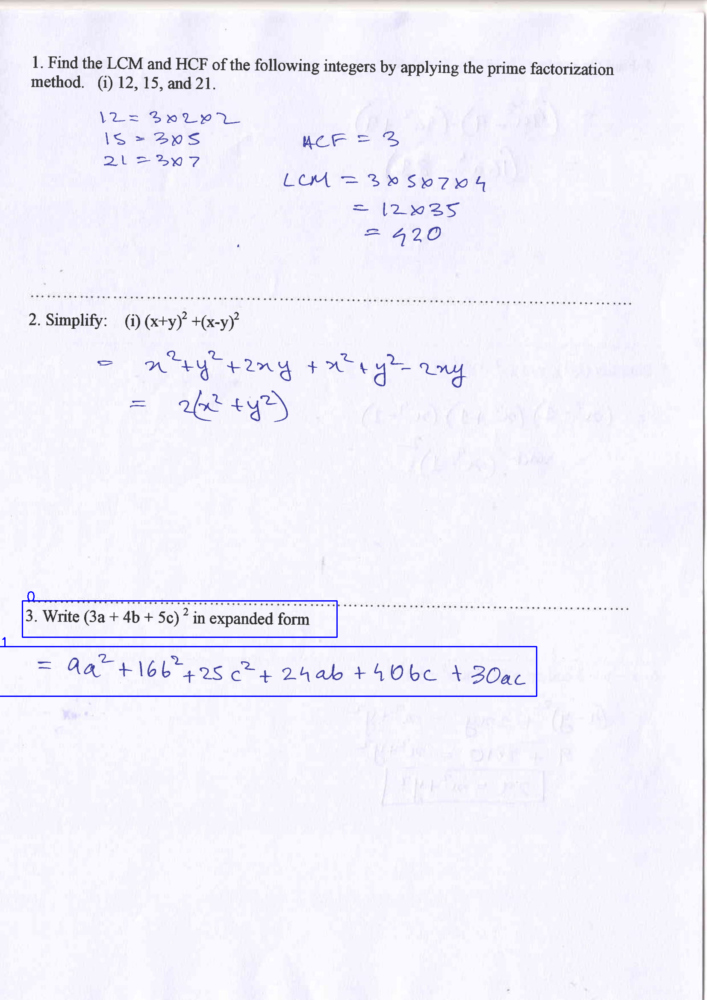

*******W1********


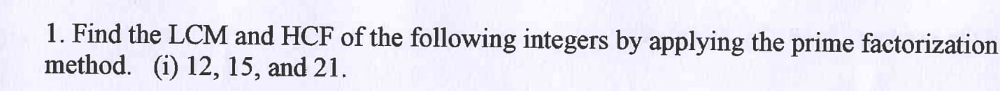

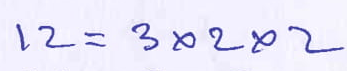

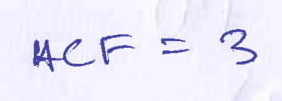

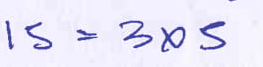

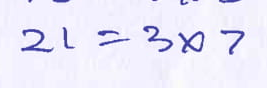

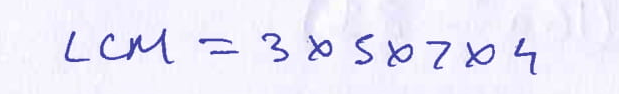

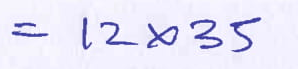

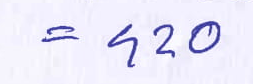

*******W2********


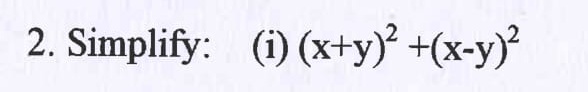

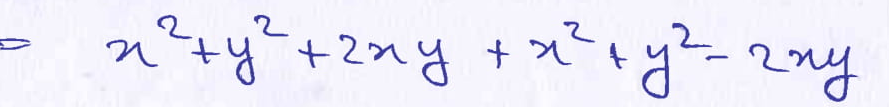

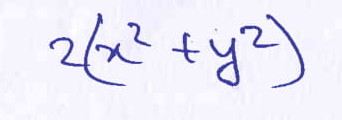

*******W3********


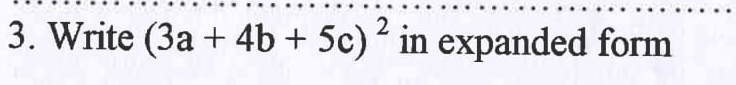

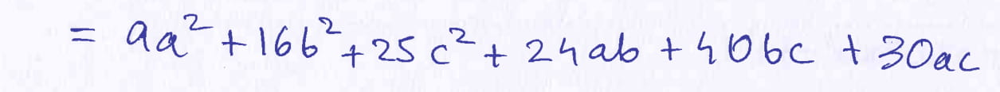

In [ ]:
lines1,lines2,lines3 = workspace_recognition(sheet1)

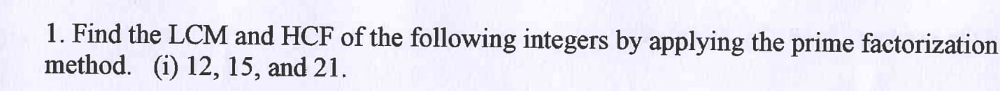

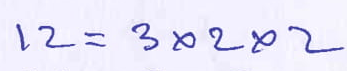

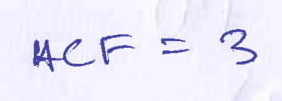

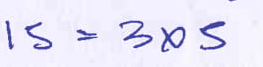

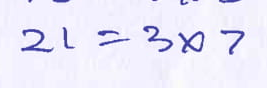

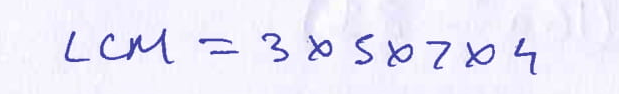

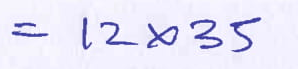

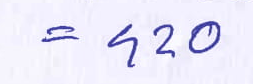

In [ ]:
show_images(lines1)

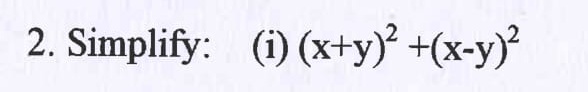

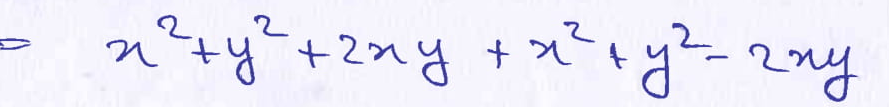

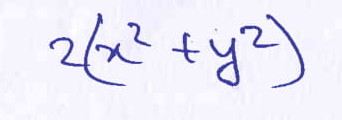

In [ ]:
show_images(lines2)

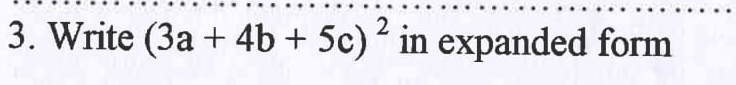

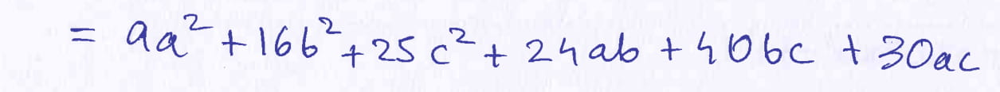

In [ ]:
show_images(lines3)

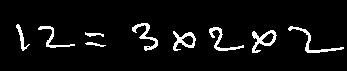

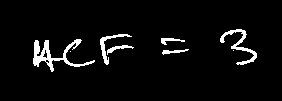

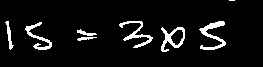

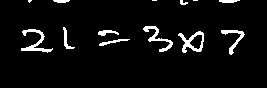

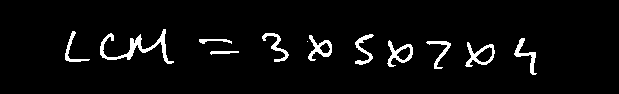

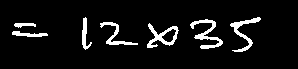

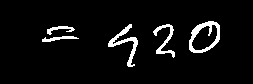

In [ ]:
eq_words1 = word_division(lines1[1:],1)

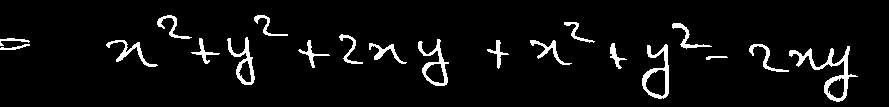

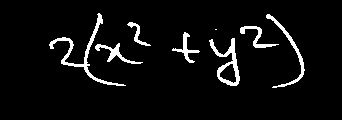

In [ ]:
eq_words2 = word_division(lines2[1:],1)

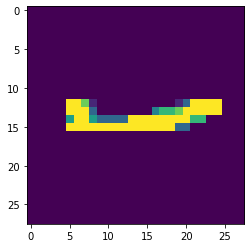

-
['-']


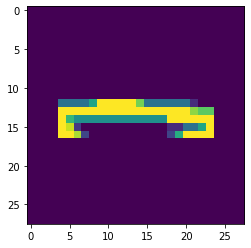

-
['-', '-']


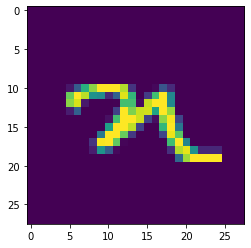

A
['-', '-', 'A']


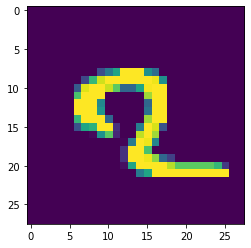

A
['-', '-', 'A', 'A']


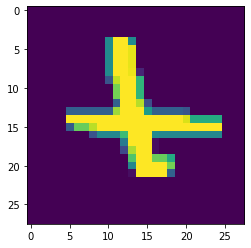

+
['-', '-', 'A', 'A', '+']


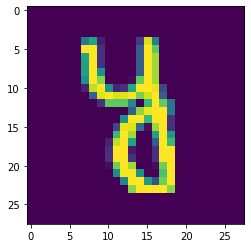

y
['-', '-', 'A', 'A', '+', 'y']


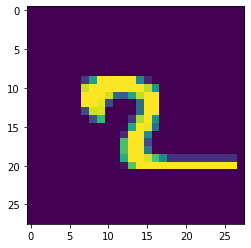

X
['-', '-', 'A', 'A', '+', 'y', 'X']


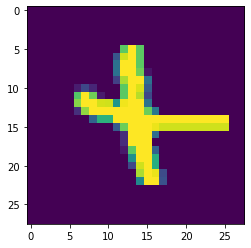

+
['-', '-', 'A', 'A', '+', 'y', 'X', '+']


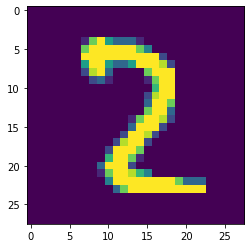

2
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2']


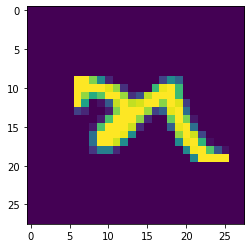

A
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A']


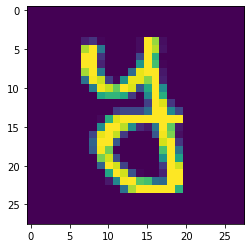

y
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y']


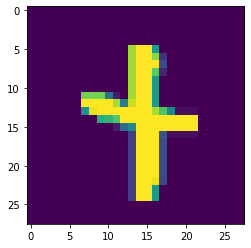

4
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4']


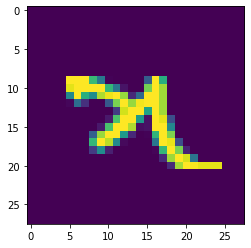

4
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4']


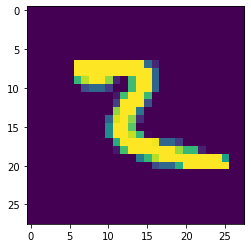

2
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4', '2']


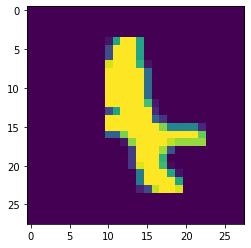

4
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4', '2', '4']


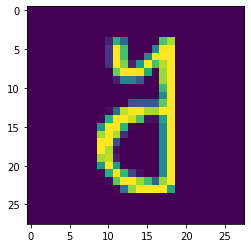

2
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4', '2', '4', '2']


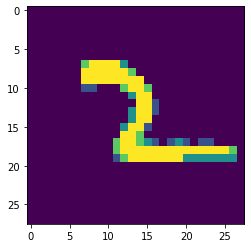

2
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4', '2', '4', '2', '2']


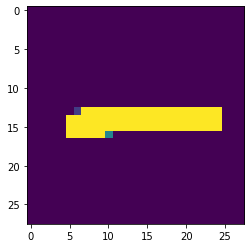

-
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4', '2', '4', '2', '2', '-']


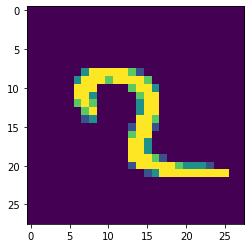

A
['-', '-', 'A', 'A', '+', 'y', 'X', '+', '2', 'A', 'y', '4', '4', '2', '4', '2', '2', '-', 'A']
RESULTANT
ORIGINAL_SOLUTION
 - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y 


['-',
 '-',
 'A',
 'A',
 '+',
 'y',
 'X',
 '+',
 '2',
 'A',
 'y',
 '4',
 '4',
 '2',
 '4',
 '2',
 '2',
 '-',
 'A']

In [ ]:
test_images = eq_words2[0][:-1]
solution_list = " - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y "
predict_using_model(test_images,solution_list)

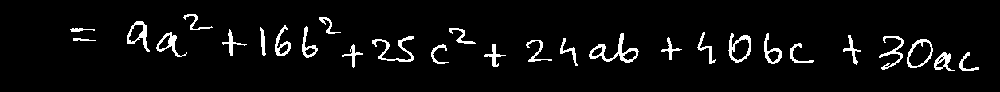

In [ ]:
eq_words3 = word_division(lines3[1:],1)

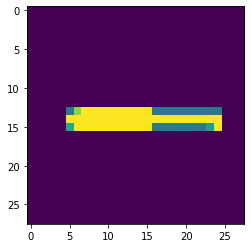

-
['-']


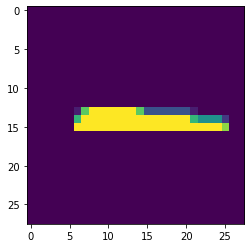

-
['-', '-']


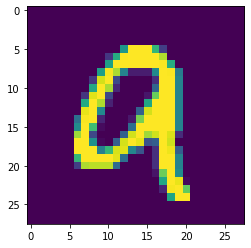

A
['-', '-', 'A']


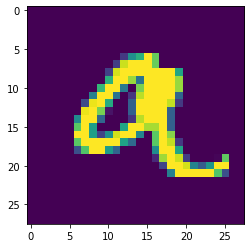

A
['-', '-', 'A', 'A']


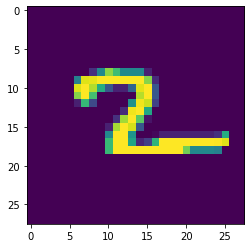

2
['-', '-', 'A', 'A', '2']


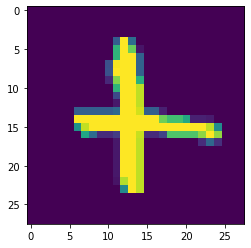

+
['-', '-', 'A', 'A', '2', '+']


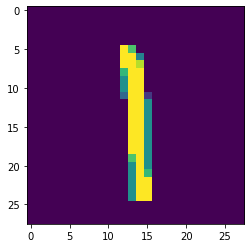

1
['-', '-', 'A', 'A', '2', '+', '1']


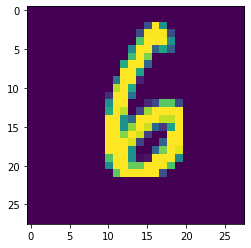

6
['-', '-', 'A', 'A', '2', '+', '1', '6']


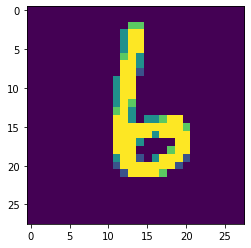

b
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b']


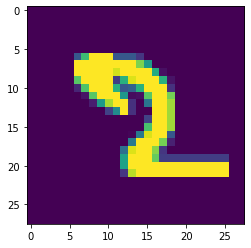

X
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X']


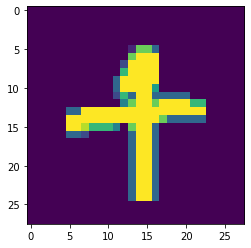

+
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+']


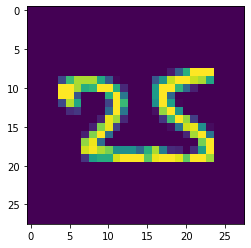

X
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X']


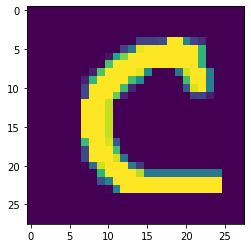

C
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C']


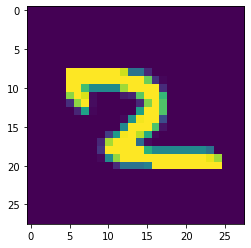

A
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A']


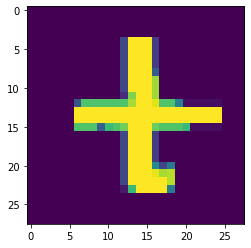

+
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+']


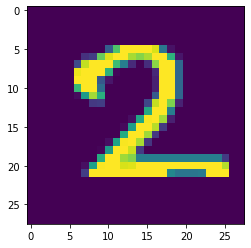

2
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2']


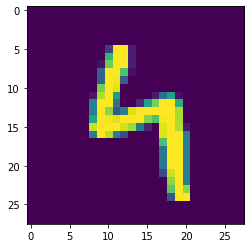

4
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4']


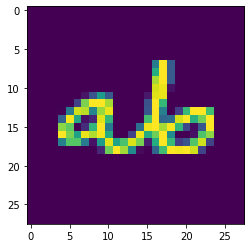

+
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+']


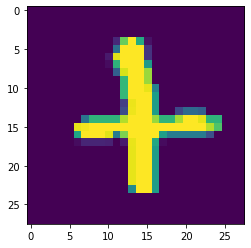

+
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+']


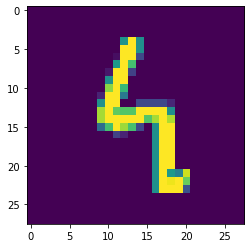

4
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4']


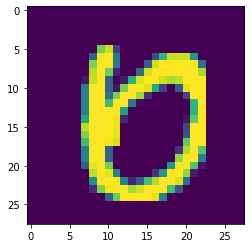

b
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b']


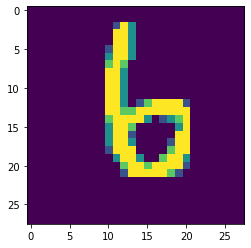

b
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b']


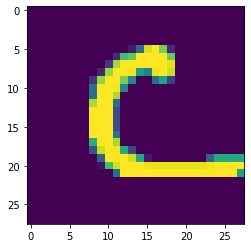

C
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b', 'C']


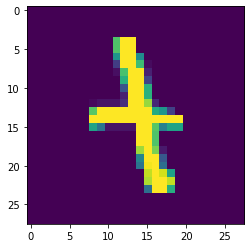

+
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b', 'C', '+']


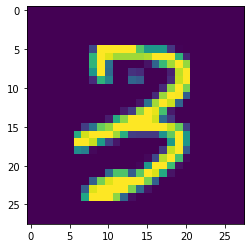

3
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b', 'C', '+', '3']


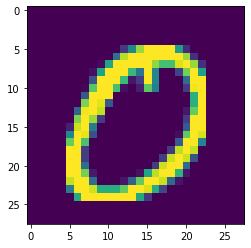

0
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b', 'C', '+', '3', '0']


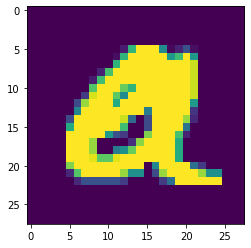

A
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b', 'C', '+', '3', '0', 'A']


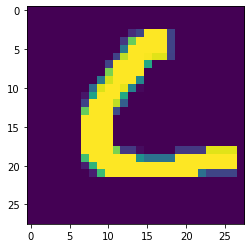

C
['-', '-', 'A', 'A', '2', '+', '1', '6', 'b', 'X', '+', 'X', 'C', 'A', '+', '2', '4', '+', '+', '4', 'b', 'b', 'C', '+', '3', '0', 'A', 'C']
RESULTANT
ORIGINAL_SOLUTION
 - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y 


['-',
 '-',
 'A',
 'A',
 '2',
 '+',
 '1',
 '6',
 'b',
 'X',
 '+',
 'X',
 'C',
 'A',
 '+',
 '2',
 '4',
 '+',
 '+',
 '4',
 'b',
 'b',
 'C',
 '+',
 '3',
 '0',
 'A',
 'C']

In [ ]:
predict_using_model(eq_words3[0],solution_list)

In [ ]:
show_images(eq_words3[0])
solution_list = ['9','A','2','+','1','6','b','2','+','2','5','C','2','+','2','4','A','b','+','4','0','b','C','+','3','0','A','C']

In [ ]:
test_images = eq_words2[1]

In [ ]:
for t in test_images:
    cv2_imshow(t)

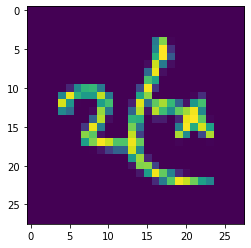

+
['+']


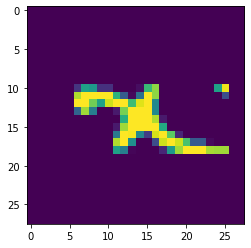

X
['+', 'X']


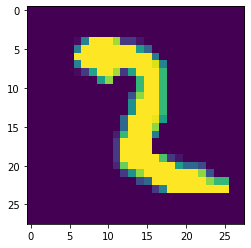

X
['+', 'X', 'X']


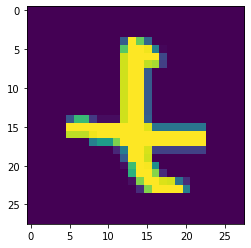

+
['+', 'X', 'X', '+']


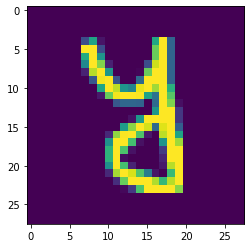

y
['+', 'X', 'X', '+', 'y']


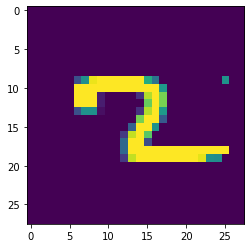

A
['+', 'X', 'X', '+', 'y', 'A']


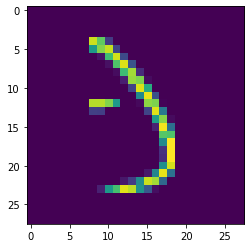

3
['+', 'X', 'X', '+', 'y', 'A', '3']
RESULTANT
ORIGINAL_SOLUTION
 - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y 


['+', 'X', 'X', '+', 'y', 'A', '3']

In [ ]:
predict_using_model(test_images,solution_list)

In [ ]:
import imutils
import argparse
import time
import cv2

def pyramid(image,scale=1.5,minSize=(30,30)):
  yield image

  while True:
    w = int(image.shape[1]/scale)
    image = imutils.resize(image,width=w)
    if image.shape[0] < minSize[1] or image.shape[1] < minSize[0]:
      break
    yield image


def sliding_window(image,stepSize,windowSize):
  for y in range(0,image.shape[0],stepSize):
    for x in range(0,image.shape[0],stepSize):
      yield(x,y,image[y:y + windowSize[1],x:x+windowSize[0]])


(winW, winH) = (14,28)
img = []
def slicing_window(image):
    for resized in pyramid(image,scale=1.5):
        for (x,y,window) in sliding_window(resized,stepSize = 14, windowSize=(winW,winH)):
            if window.shape[0] != winH or window.shape[1] != winW:
                continue
            clone = resized.copy()
    #cv2.rectangle(clone,(x,y),(x+winW,y+winH),(0,255,0),2)
            image = clone[y:y+winH,x:x+winW]
            cv2_imshow(image)
            img.append(image)
    #cv2_imshow(clone)
            time.sleep(0.025)
    return img

In [ ]:
img = slicing_window(test_image)

In [ ]:
def process_sw(img):
    for i in img:
        cv2_imshow(i)
        new = cv2.resize(i,(28,28))
        kernel = np.ones((2,2),np.uint8)
        dilation = cv2.dilate(new,kernel,iterations = 1)
        new = process_img(dilation)
        cv2_imshow(new)

In [ ]:
new_list = []
for i in img:
    cv2_imshow(i)
    kernel = np.ones((2,2), np.uint8)
    dilation = cv2.dilate(i,kernel,iterations = 1)
    new = process_img(dilation)
    cv2_imshow(new)
    new_list.append(new)

SH004-2.jpg


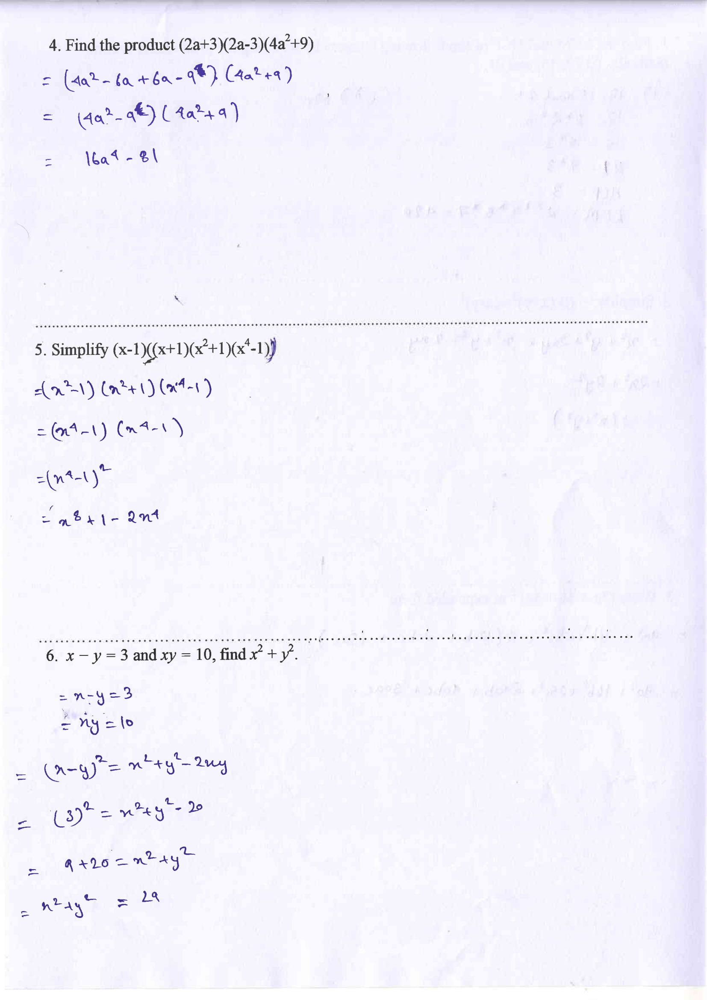

(2339, 1654, 3)


In [ ]:
sheet1 = show_sheet(23)

0  y1 =  76  x1 =  101  y2 =  130  x2 =  751
1  y1 =  139  x1 =  110  y2 =  211  x2 =  691
2  y1 =  227  x1 =  112  y2 =  301  x2 =  611
3  y1 =  327  x1 =  96  y2 =  420  x2 =  415
4  y1 =  787  x1 =  57  y2 =  849  x2 =  663
5  y1 =  875  x1 =  48  y2 =  947  x2 =  537
6  y1 =  967  x1 =  54  y2 =  1044  x2 =  451
7  y1 =  1077  x1 =  78  y2 =  1149  x2 =  297
8  y1 =  1178  x1 =  87  y2 =  1246  x2 =  424
9  y1 =  1504  x1 =  85  y2 =  1570  x2 =  724
10  y1 =  1607  x1 =  127  y2 =  1652  x2 =  328
11  y1 =  1664  x1 =  131  y2 =  1728  x2 =  345
12  y1 =  1760  x1 =  52  y2 =  1833  x2 =  559
13  y1 =  1863  x1 =  42  y2 =  1942  x2 =  508
14  y1 =  1985  x1 =  78  y2 =  2048  x2 =  504
15  y1 =  2075  x1 =  51  y2 =  2151  x2 =  432


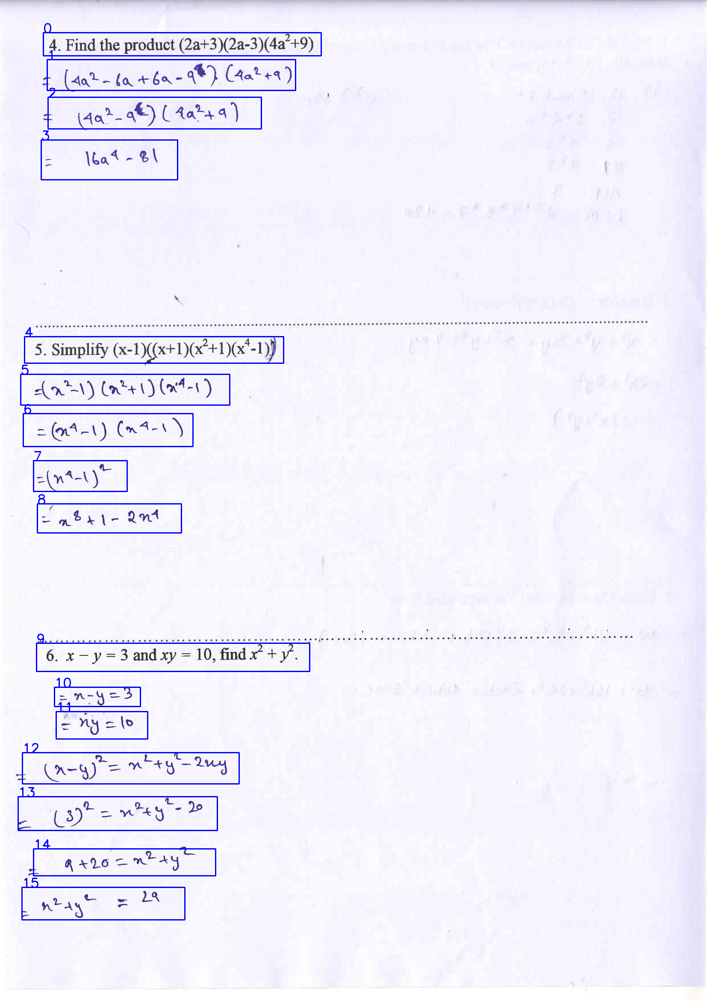

0 y1 =  76 x1 =  101 y2 =  130 x2 =  751
1 y1 =  139 x1 =  110 y2 =  211 x2 =  691
2 y1 =  227 x1 =  112 y2 =  301 x2 =  611
3 y1 =  327 x1 =  96 y2 =  420 x2 =  415


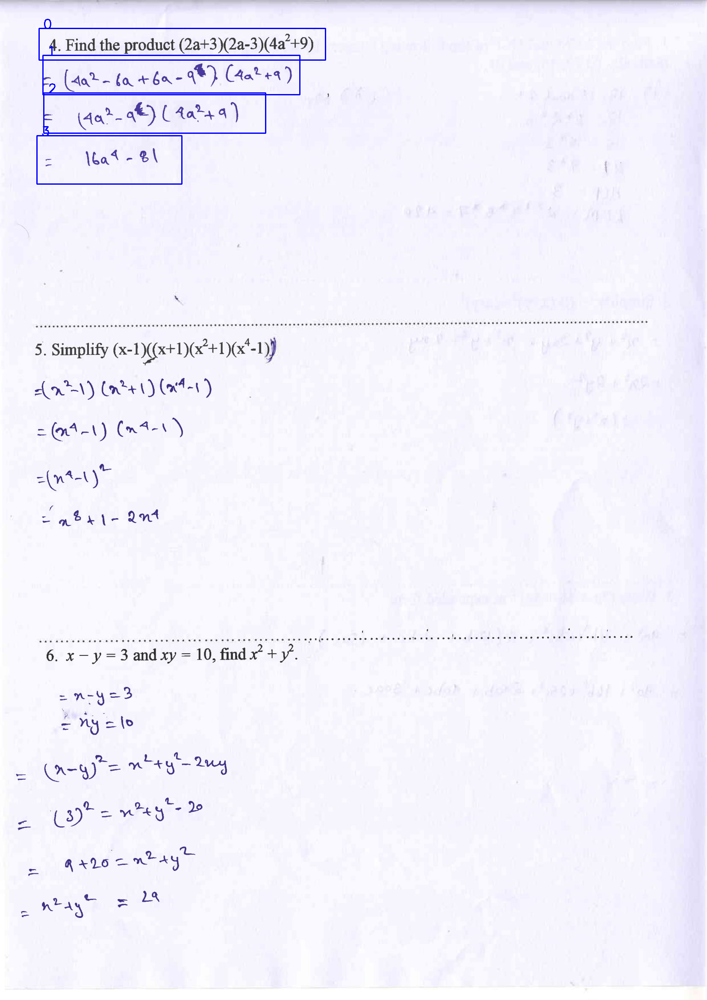

0 y1 =  787 x1 =  57 y2 =  849 x2 =  663
1 y1 =  875 x1 =  48 y2 =  947 x2 =  537
2 y1 =  967 x1 =  54 y2 =  1044 x2 =  451
3 y1 =  1077 x1 =  78 y2 =  1149 x2 =  297
4 y1 =  1178 x1 =  87 y2 =  1246 x2 =  424


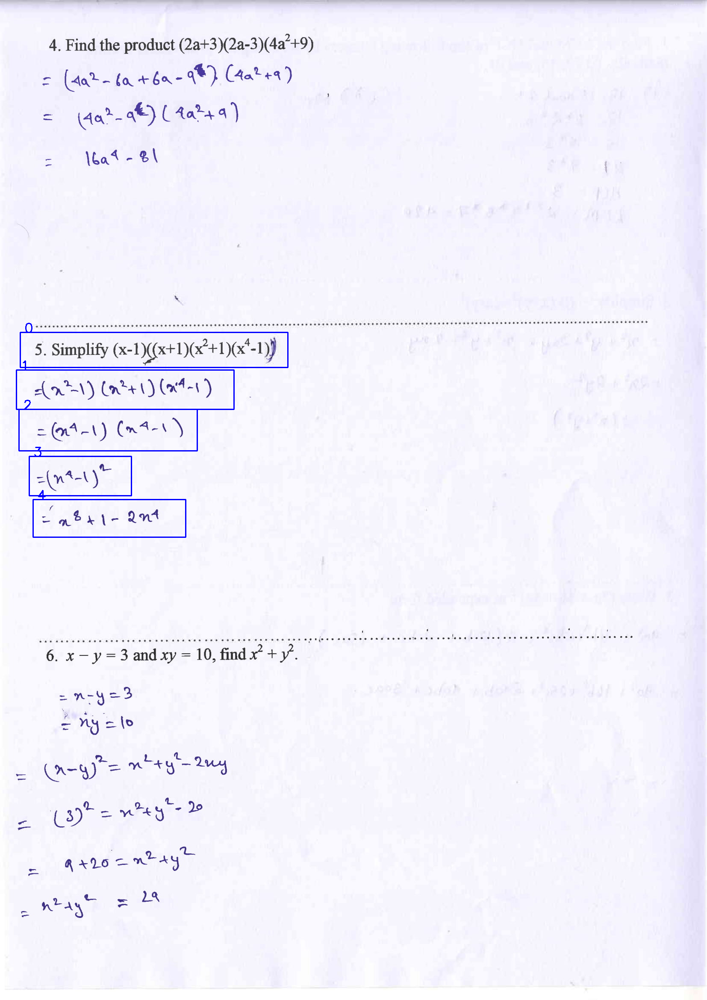

0 y1 =  1504 x1 =  85 y2 =  1570 x2 =  724
1 y1 =  1607 x1 =  127 y2 =  1652 x2 =  328
2 y1 =  1664 x1 =  131 y2 =  1728 x2 =  345
3 y1 =  1760 x1 =  52 y2 =  1833 x2 =  559
4 y1 =  1863 x1 =  42 y2 =  1942 x2 =  508
5 y1 =  1985 x1 =  78 y2 =  2048 x2 =  504
6 y1 =  2075 x1 =  51 y2 =  2151 x2 =  432


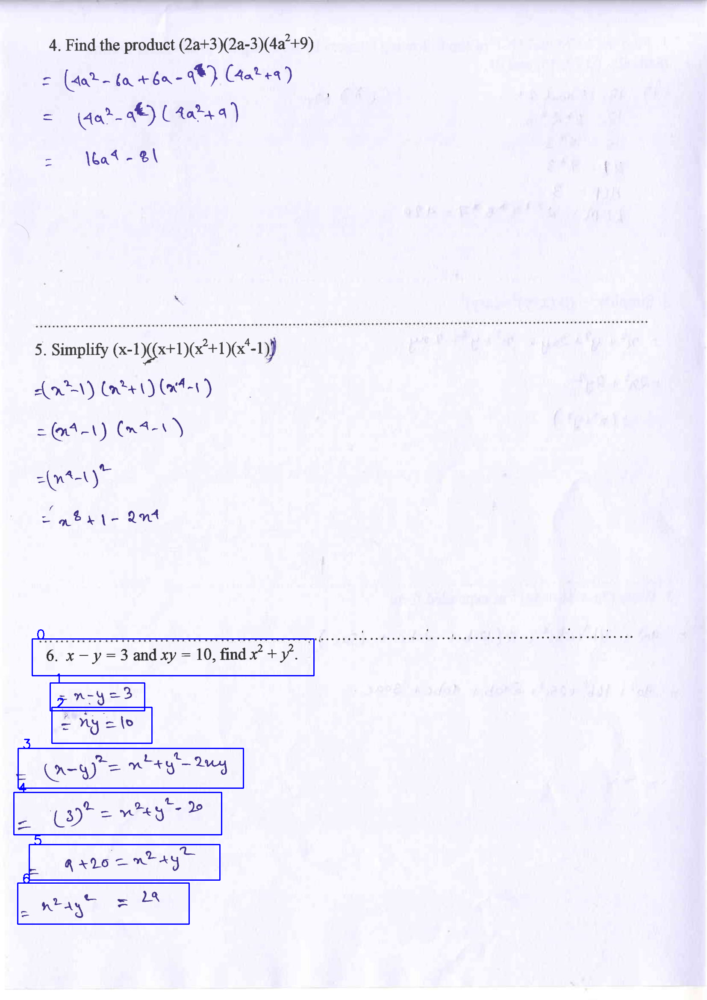

*******W1********


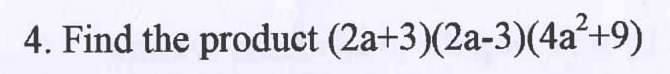

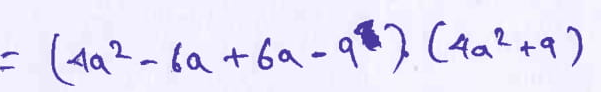

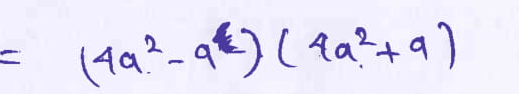

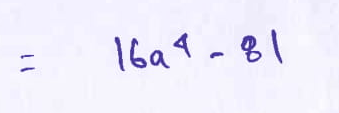

*******W2********


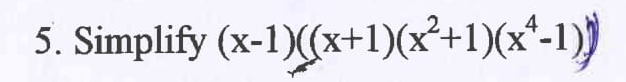

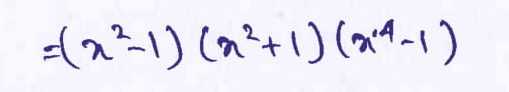

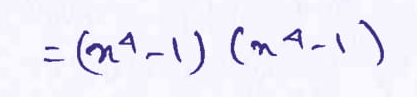

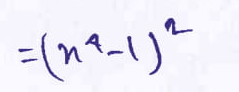

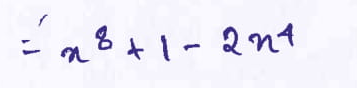

*******W3********


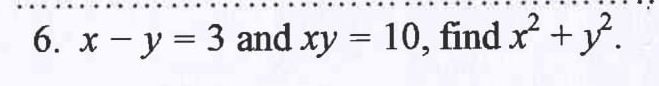

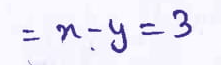

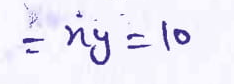

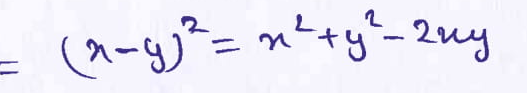

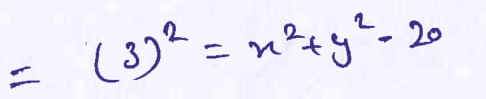

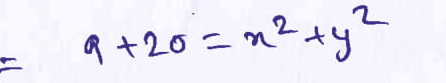

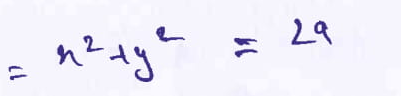

In [ ]:
lines1,lines2,lines3 = workspace_recognition(sheet1)

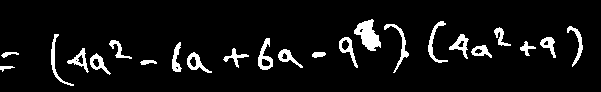

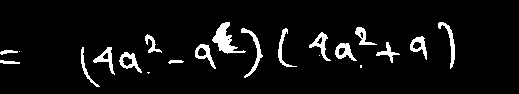

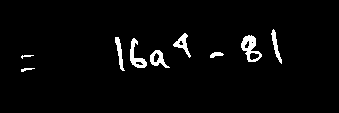

In [ ]:
eq_words1 = word_division(lines1[1:],0)

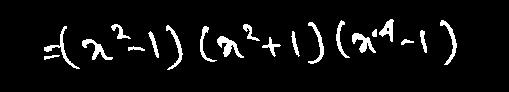

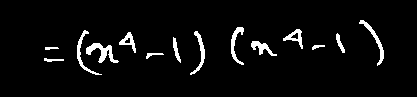

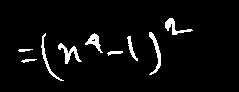

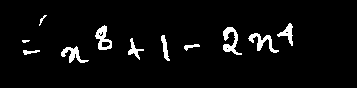

In [ ]:
eq_words2 = word_division(lines2[1:],0)

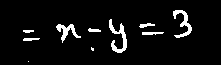

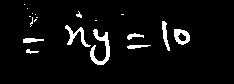

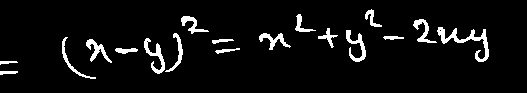

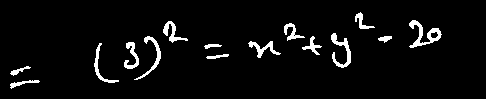

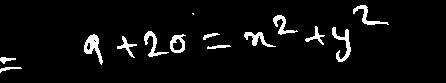

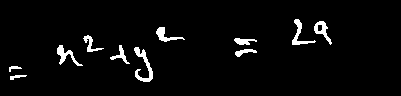

In [ ]:
eq_words3 = word_division(lines3[1:],0)

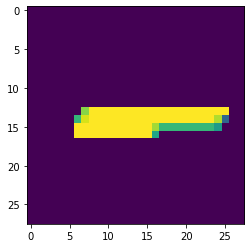

-
['-']


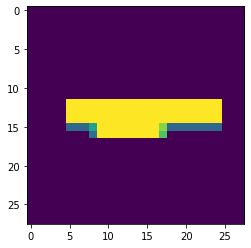

-
['-', '-']


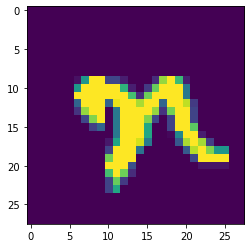

4
['-', '-', '4']


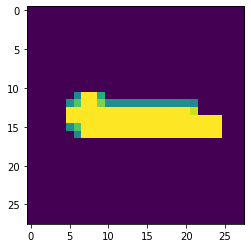

-
['-', '-', '4', '-']


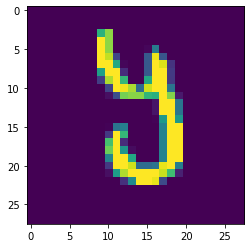

b
['-', '-', '4', '-', 'b']


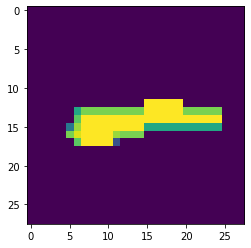

-
['-', '-', '4', '-', 'b', '-']


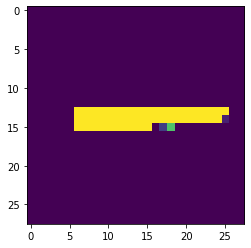

-
['-', '-', '4', '-', 'b', '-', '-']


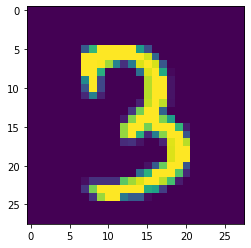

3
['-', '-', '4', '-', 'b', '-', '-', '3']


['-', '-', '4', '-', 'b', '-', '-', '3']

In [ ]:
predict(eq_words3[0])

SH008-2.jpg


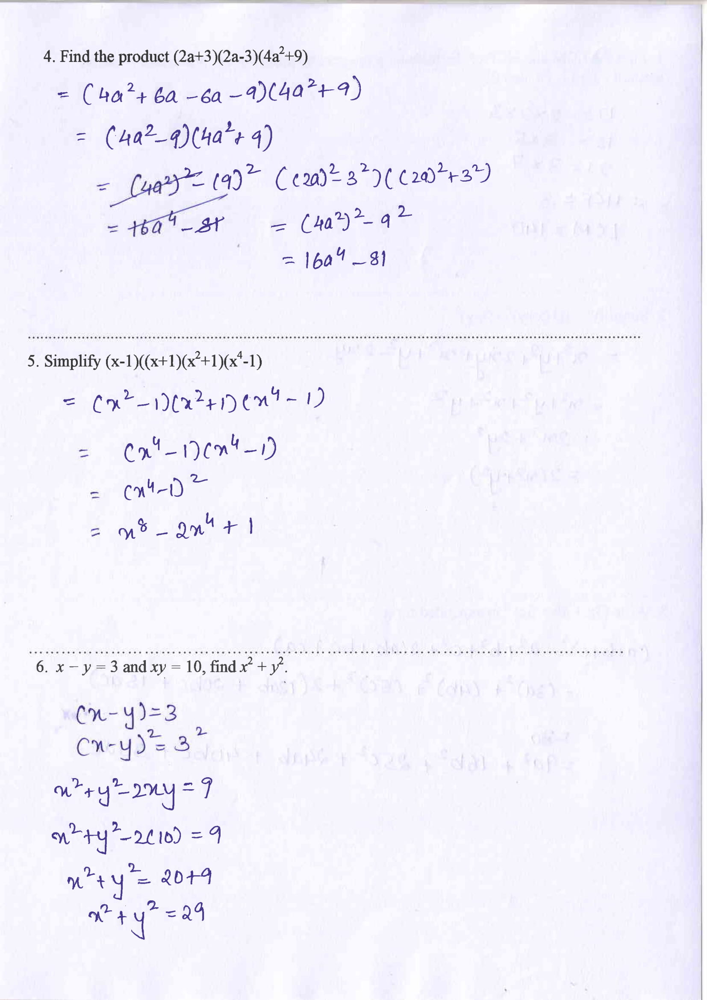

(2339, 1654, 3)


In [ ]:
sheet3 = show_sheet(2)

0  y1 =  102  x1 =  100  y2 =  158  x2 =  719
1  y1 =  171  x1 =  87  y2 =  258  x2 =  862
2  y1 =  274  x1 =  216  y2 =  357  x2 =  657
3  y1 =  376  x1 =  268  y2 =  462  x2 =  875
4  y1 =  470  x1 =  254  y2 =  544  x2 =  991
5  y1 =  488  x1 =  231  y2 =  571  x2 =  559
6  y1 =  566  x1 =  619  y2 =  640  x2 =  955
7  y1 =  819  x1 =  45  y2 =  869  x2 =  613
8  y1 =  898  x1 =  153  y2 =  974  x2 =  792
9  y1 =  1013  x1 =  168  y2 =  1081  x2 =  675
10  y1 =  1105  x1 =  203  y2 =  1175  x2 =  513
11  y1 =  1192  x1 =  190  y2 =  1277  x2 =  664
12  y1 =  1531  x1 =  39  y2 =  1593  x2 =  688
13  y1 =  1630  x1 =  161  y2 =  1706  x2 =  447
14  y1 =  1700  x1 =  153  y2 =  1787  x2 =  499
15  y1 =  1816  x1 =  123  y2 =  1892  x2 =  532
16  y1 =  1917  x1 =  76  y2 =  1997  x2 =  543
17  y1 =  2020  x1 =  141  y2 =  2088  x2 =  541
18  y1 =  2104  x1 =  193  y2 =  2194  x2 =  525


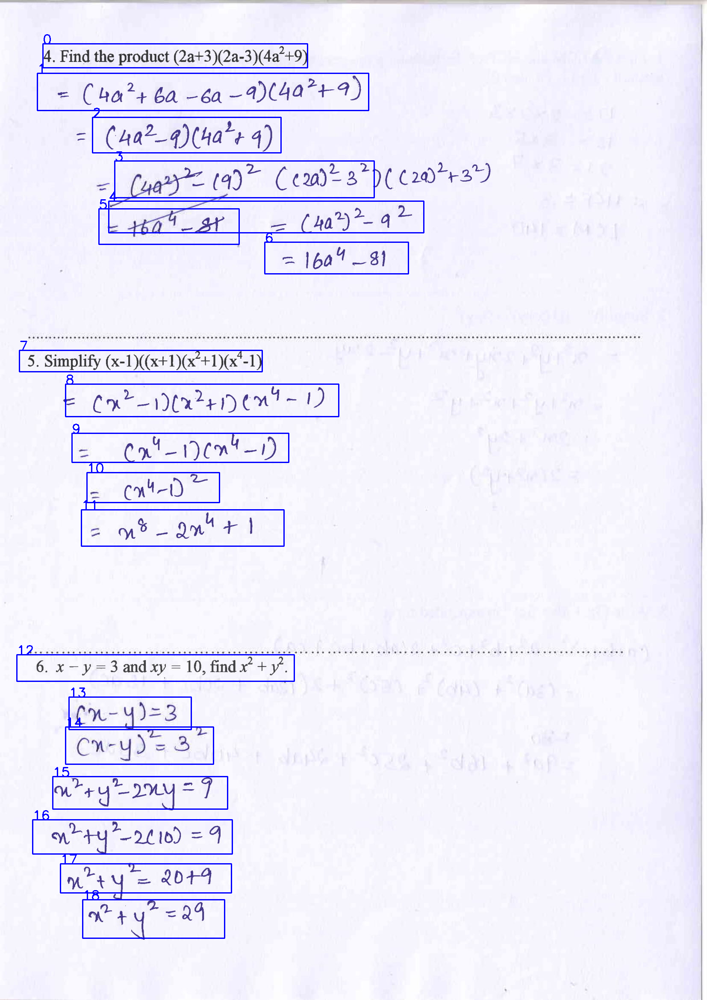

0 y1 =  102 x1 =  100 y2 =  158 x2 =  719
1 y1 =  171 x1 =  87 y2 =  258 x2 =  862
2 y1 =  274 x1 =  216 y2 =  357 x2 =  657
3 y1 =  376 x1 =  268 y2 =  462 x2 =  875
4 y1 =  470 x1 =  254 y2 =  544 x2 =  991
5 y1 =  488 x1 =  231 y2 =  571 x2 =  559
6 y1 =  566 x1 =  619 y2 =  640 x2 =  955


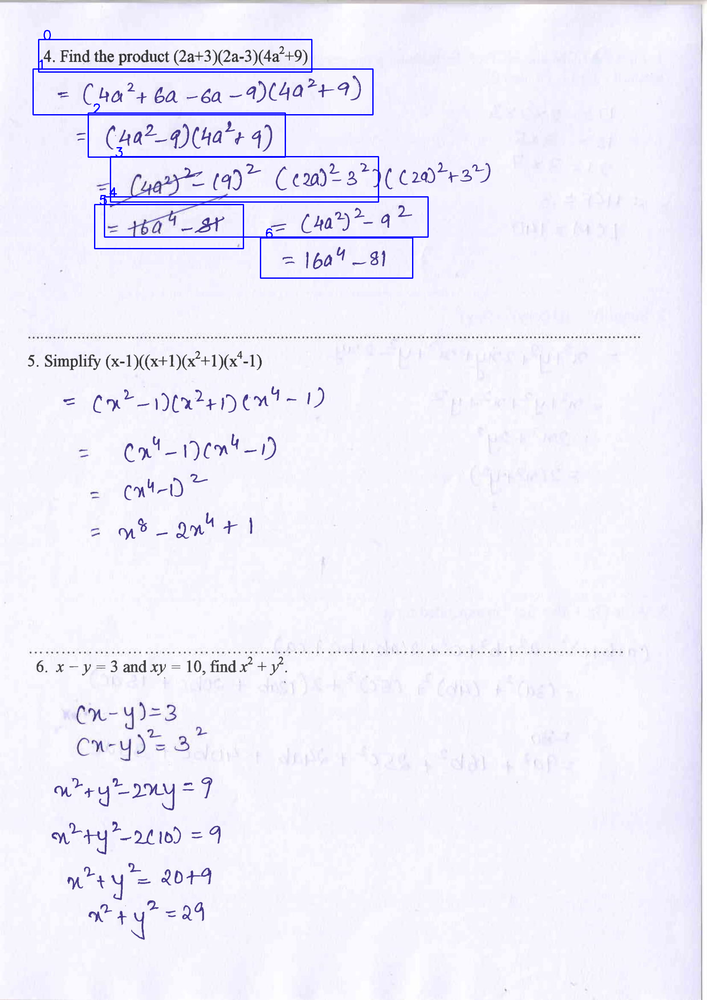

0 y1 =  819 x1 =  45 y2 =  869 x2 =  613
1 y1 =  898 x1 =  153 y2 =  974 x2 =  792
2 y1 =  1013 x1 =  168 y2 =  1081 x2 =  675
3 y1 =  1105 x1 =  203 y2 =  1175 x2 =  513
4 y1 =  1192 x1 =  190 y2 =  1277 x2 =  664


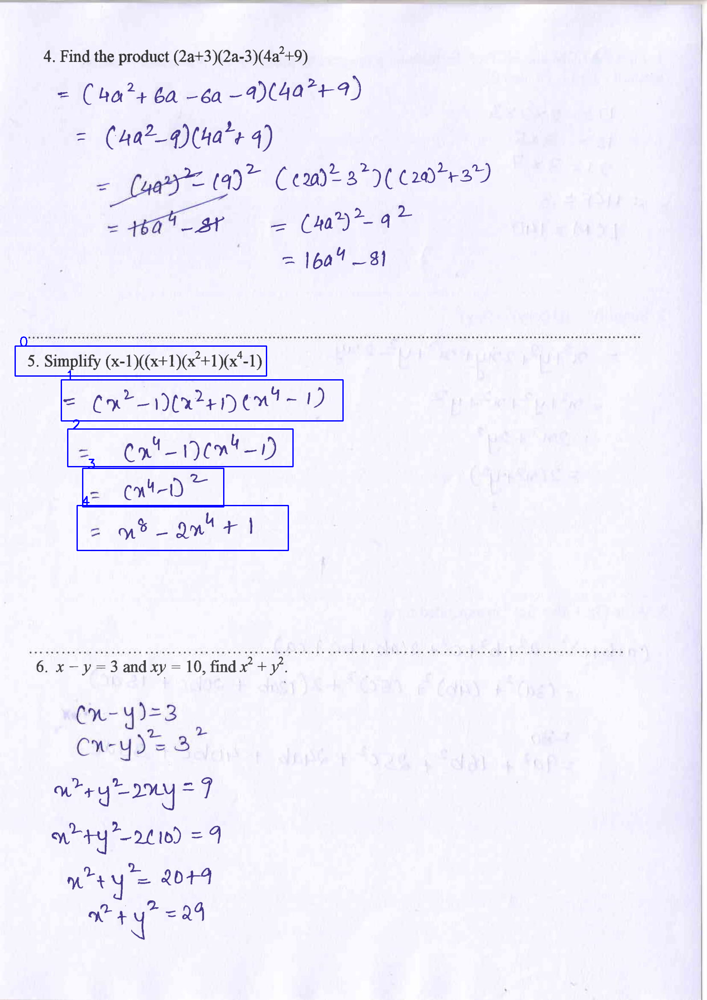

0 y1 =  1531 x1 =  39 y2 =  1593 x2 =  688
1 y1 =  1630 x1 =  161 y2 =  1706 x2 =  447
2 y1 =  1700 x1 =  153 y2 =  1787 x2 =  499
3 y1 =  1816 x1 =  123 y2 =  1892 x2 =  532
4 y1 =  1917 x1 =  76 y2 =  1997 x2 =  543
5 y1 =  2020 x1 =  141 y2 =  2088 x2 =  541
6 y1 =  2104 x1 =  193 y2 =  2194 x2 =  525


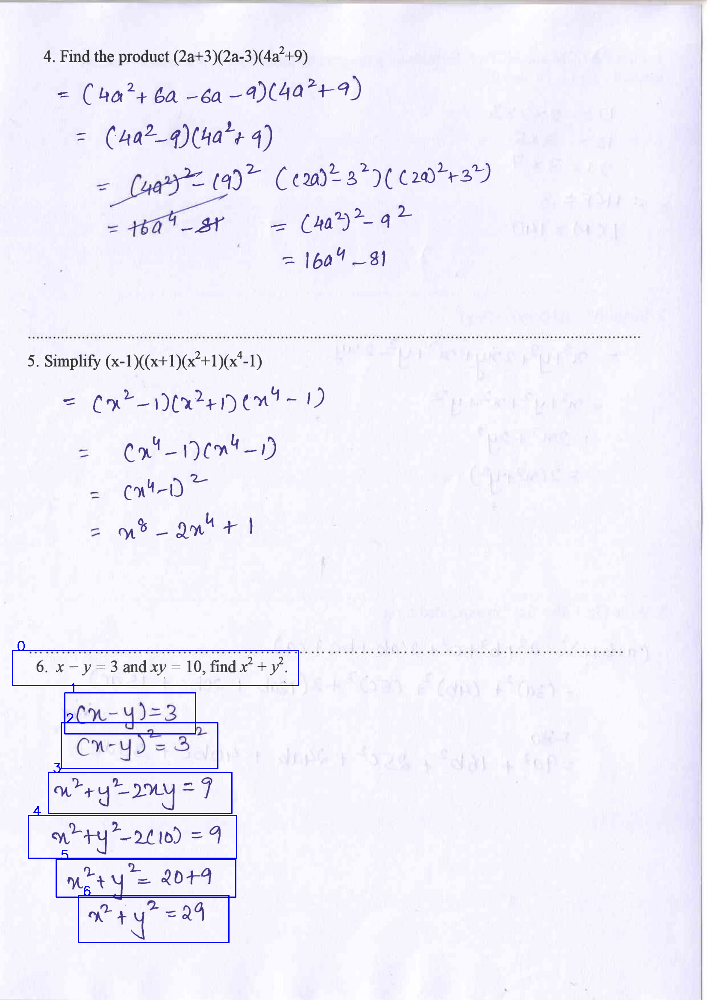

*******W1********


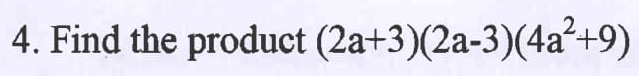

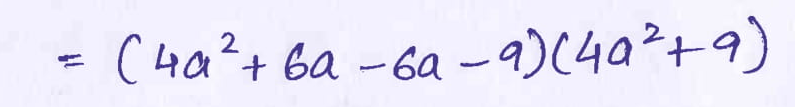

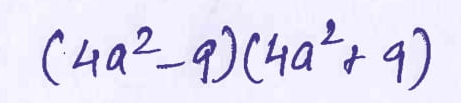

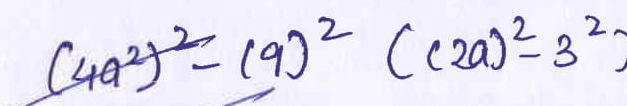

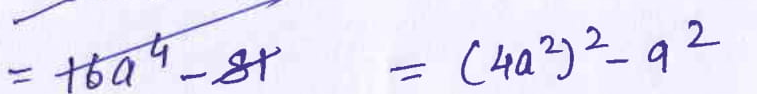

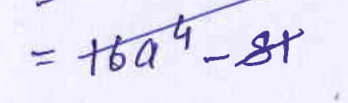

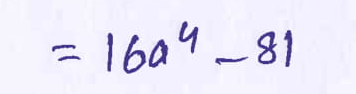

*******W2********


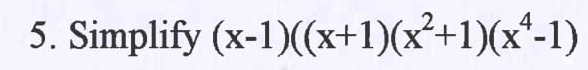

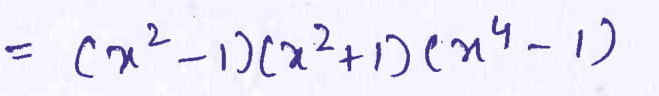

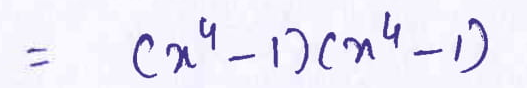

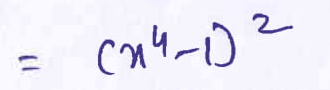

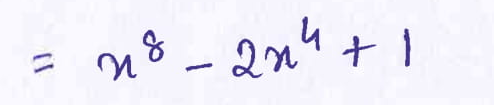

*******W3********


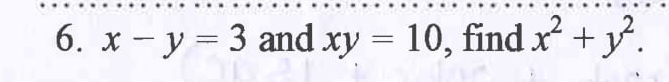

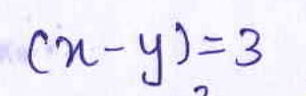

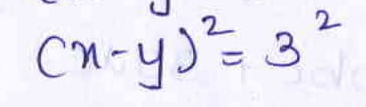

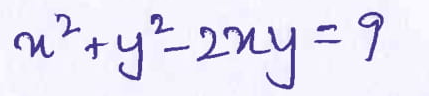

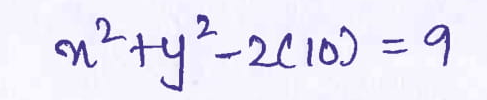

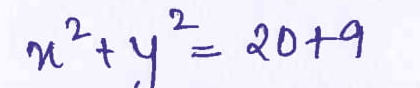

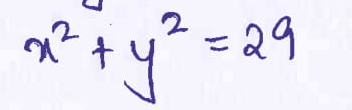

In [ ]:
lines1,lines2,lines3 = workspace_recognition(sheet3)

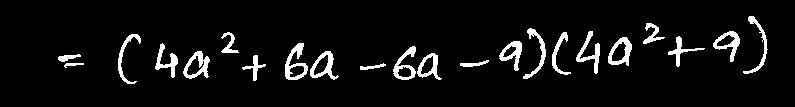

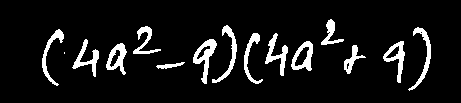

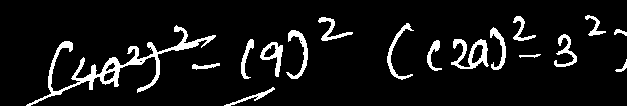

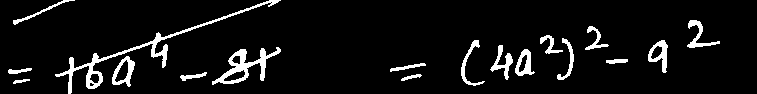

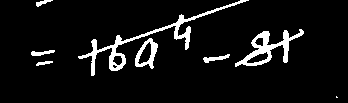

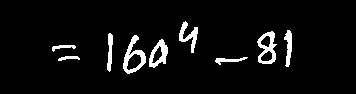

In [ ]:
eq_words1 = word_division(lines1[1:],0)

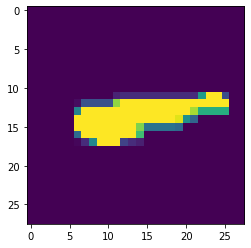

-
['-']


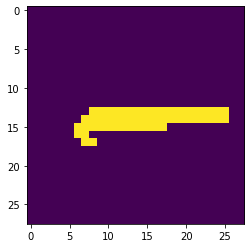

-
['-', '-']


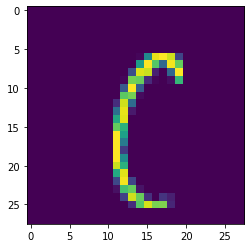

(
['-', '-', '(']


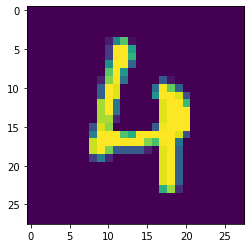

4
['-', '-', '(', '4']


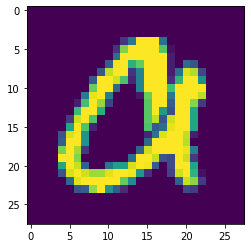

A
['-', '-', '(', '4', 'A']


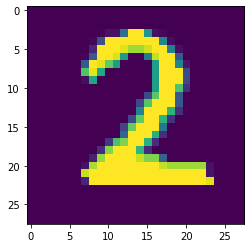

2
['-', '-', '(', '4', 'A', '2']


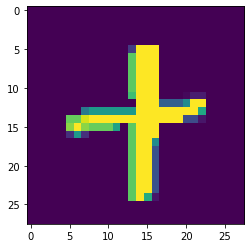

+
['-', '-', '(', '4', 'A', '2', '+']


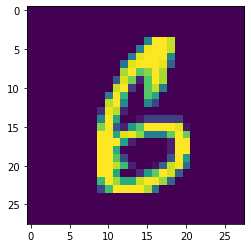

6
['-', '-', '(', '4', 'A', '2', '+', '6']


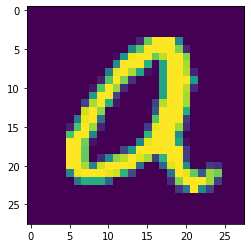

A
['-', '-', '(', '4', 'A', '2', '+', '6', 'A']


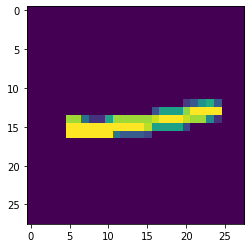

-
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-']


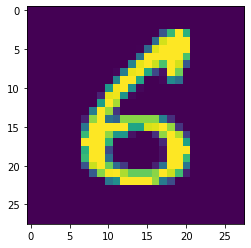

6
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6']


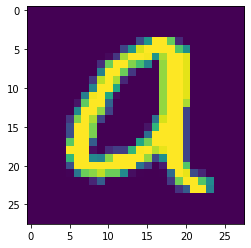

A
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A']


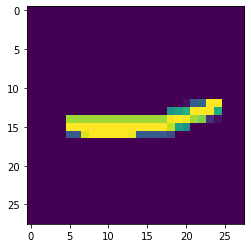

-
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-']


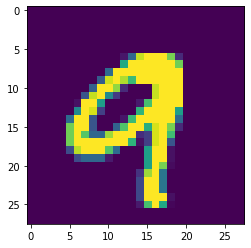

9
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9']


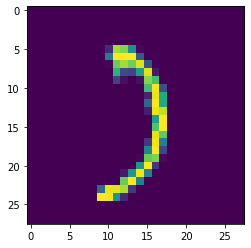

)
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')']


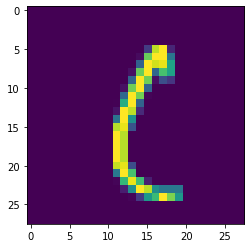

(
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(']


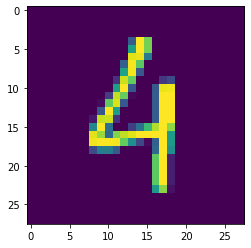

4
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(', '4']


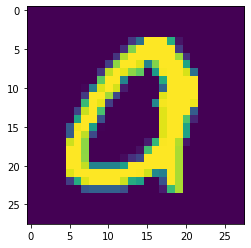

A
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(', '4', 'A']


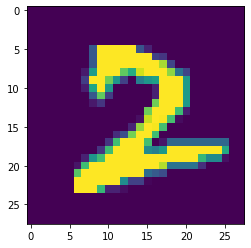

2
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(', '4', 'A', '2']


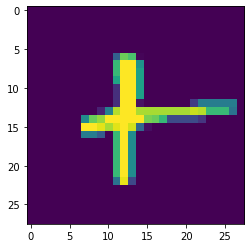

+
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(', '4', 'A', '2', '+']


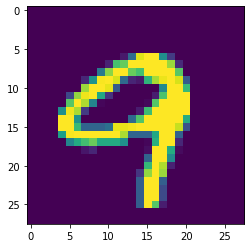

7
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(', '4', 'A', '2', '+', '7']


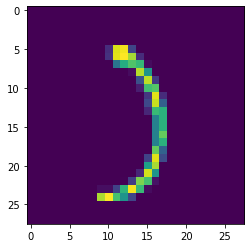

)
['-', '-', '(', '4', 'A', '2', '+', '6', 'A', '-', '6', 'A', '-', '9', ')', '(', '4', 'A', '2', '+', '7', ')']
RESULTANT
ORIGINAL_SOLUTION
 - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y 


['-',
 '-',
 '(',
 '4',
 'A',
 '2',
 '+',
 '6',
 'A',
 '-',
 '6',
 'A',
 '-',
 '9',
 ')',
 '(',
 '4',
 'A',
 '2',
 '+',
 '7',
 ')']

In [ ]:
predict_using_model(test_images,solution_list)

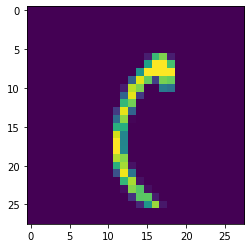

1
['1']


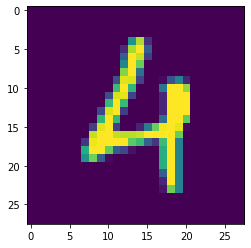

4
['1', '4']


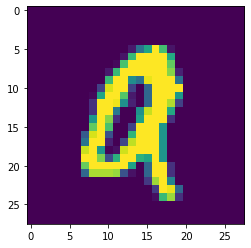

A
['1', '4', 'A']


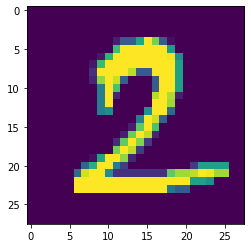

2
['1', '4', 'A', '2']


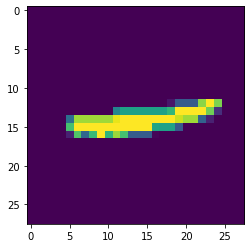

-
['1', '4', 'A', '2', '-']


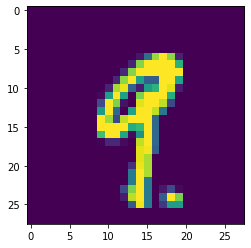

9
['1', '4', 'A', '2', '-', '9']


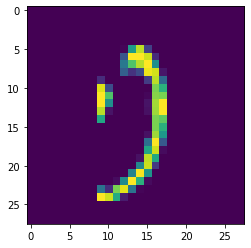

)
['1', '4', 'A', '2', '-', '9', ')']


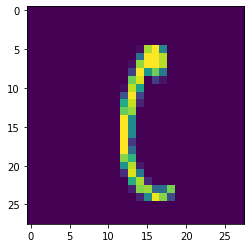

(
['1', '4', 'A', '2', '-', '9', ')', '(']


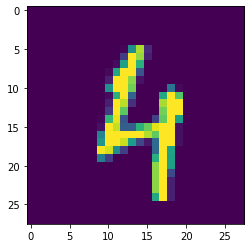

4
['1', '4', 'A', '2', '-', '9', ')', '(', '4']


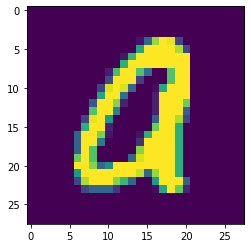

A
['1', '4', 'A', '2', '-', '9', ')', '(', '4', 'A']


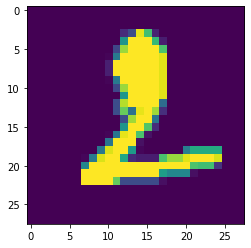

2
['1', '4', 'A', '2', '-', '9', ')', '(', '4', 'A', '2']


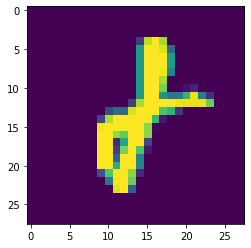

+
['1', '4', 'A', '2', '-', '9', ')', '(', '4', 'A', '2', '+']


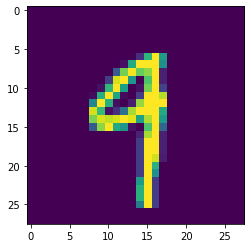

4
['1', '4', 'A', '2', '-', '9', ')', '(', '4', 'A', '2', '+', '4']


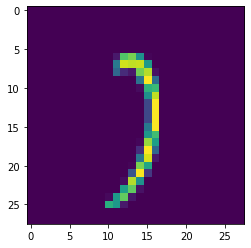

)
['1', '4', 'A', '2', '-', '9', ')', '(', '4', 'A', '2', '+', '4', ')']
RESULTANT
ORIGINAL_SOLUTION
 - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y 


['1', '4', 'A', '2', '-', '9', ')', '(', '4', 'A', '2', '+', '4', ')']

In [ ]:
test_images = eq_words1[1]
predict_using_model(test_images,solution_list)

In [ ]:
def predict_using_model_1(row1,solution_list): 
  resultant_list = []
  class_dict = {'0': 0, '1': 1, '2': 2, '3': 3, '4': 4, '5': 5, '6': 6, '7': 7, '8': 8, '9': 9, 'A': 10, 'b': 11, 'C': 12, 'X': 13, 'y': 14, 'z': 15, '(': 16, ')': 17, '+': 18, '-': 19, 'times': 20}
  print("################################################## MODEL 1 ********************************************************")
  for i in row1:
    plt.imshow(i)
    plt.show()
    img = np.expand_dims(i,axis=0)
    img = img.reshape(1,28,28,1)
    img = img/255
    y_prob = model_1.predict(img)
    #y_classes1 = keras.utils.np_utils.probas_to_classes(y_prob)
    #print(y_classes1)
    y_classes = y_prob.argmax(axis=1)
    key = get_key1(y_classes[0],class_dict)
    print(key)
    resultant_list.append(key)
    print(resultant_list)
  print("RESULTANT")  
  print(' '.join(resultant_list))
  print("ORIGINAL_SOLUTION")
  print(solution_list)  

In [ ]:
def predict_using_model_2(row1,solution_list): 
  resultant_list = []
  class_dict = {'0': 0, '1': 1, '2': 2, '3': 3, '4': 4, '5': 5, '6': 6, '7': 7, '8': 8, '9': 9, 'A': 10, 'b': 11, 'C': 12, 'X': 13, 'y': 14, 'z': 15, '(': 16, ')': 17, '+': 18, '-': 19, 'times': 20}
  print("################################################## MODEL 2 ********************************************************")
  for i in row1:
    plt.imshow(i)
    plt.show()
    img = np.expand_dims(i,axis=0)
    img = img.reshape(1,28,28,1)
    img = img/255
    y_prob = model_2.predict(img)
    #y_classes1 = keras.utils.np_utils.probas_to_classes(y_prob)
    #print(y_classes1)
    y_classes = y_prob.argmax(axis=1)
    key = get_key1(y_classes[0],class_dict)
    print(key)
    resultant_list.append(key)
    print(resultant_list)
  print("RESULTANT")  
  print(' '.join(resultant_list))
  print("ORIGINAL_SOLUTION")
  print(solution_list)  

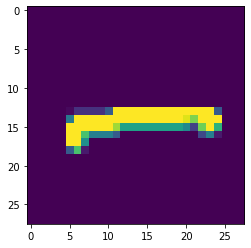

-
['-']


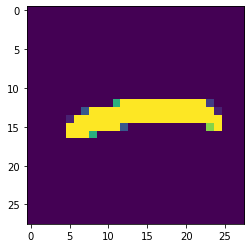

-
['-', '-']


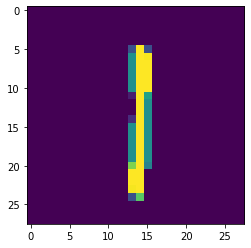

1
['-', '-', '1']


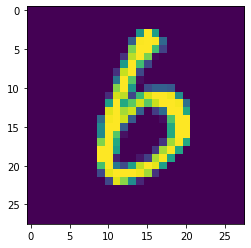

6
['-', '-', '1', '6']


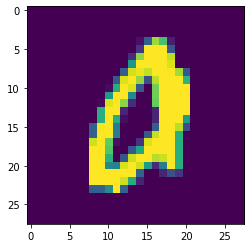

A
['-', '-', '1', '6', 'A']


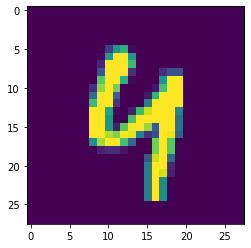

4
['-', '-', '1', '6', 'A', '4']


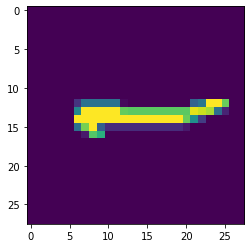

-
['-', '-', '1', '6', 'A', '4', '-']


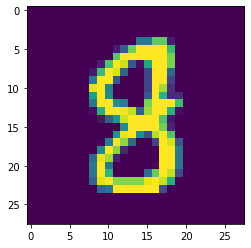

8
['-', '-', '1', '6', 'A', '4', '-', '8']


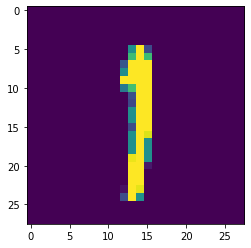

1
['-', '-', '1', '6', 'A', '4', '-', '8', '1']
RESULTANT
- - 1 6 A 4 - 8 1
ORIGINAL_SOLUTION
 - - x 2 + y 2 + 2 x y + x 2 + y 2 - 2 x y 


In [ ]:
test_images = eq_words1[-1]
predict_using_model(test_images,solution_list)

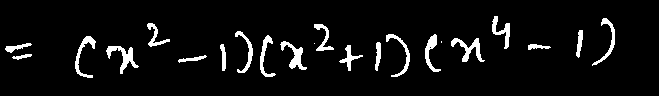

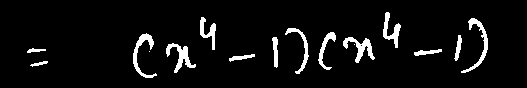

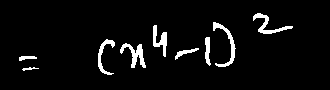

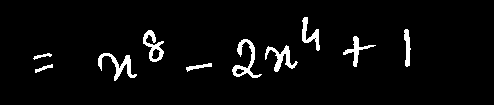

In [ ]:
eq_words2 = word_division(lines2[1:],0)

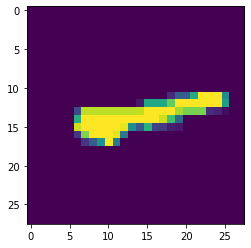

-
['-']


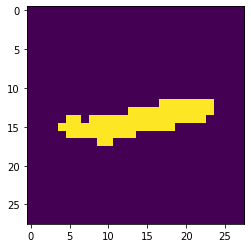

-
['-', '-']


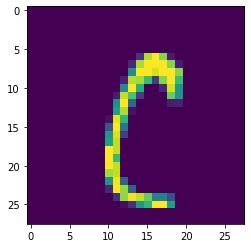

7
['-', '-', '7']


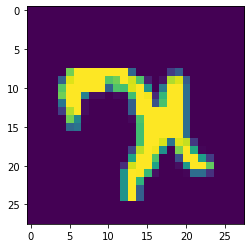

9
['-', '-', '7', '9']


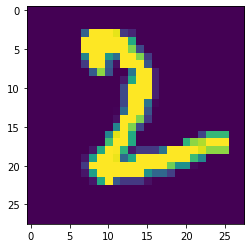

2
['-', '-', '7', '9', '2']


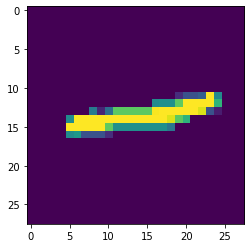

-
['-', '-', '7', '9', '2', '-']


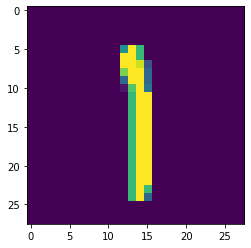

1
['-', '-', '7', '9', '2', '-', '1']


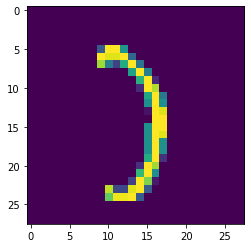

)
['-', '-', '7', '9', '2', '-', '1', ')']


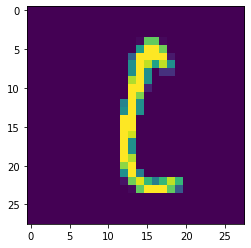

(
['-', '-', '7', '9', '2', '-', '1', ')', '(']


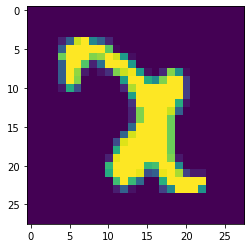

X
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X']


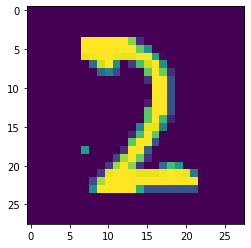

2
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2']


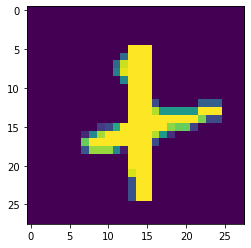

+
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+']


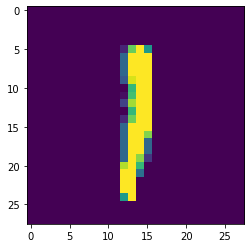

1
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1']


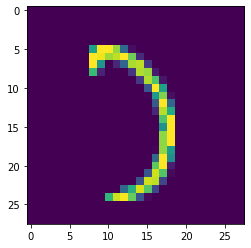

3
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3']


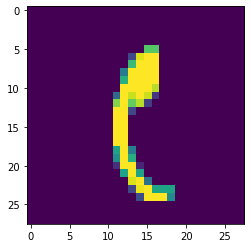

(
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3', '(']


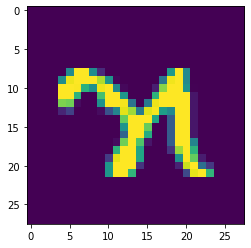

X
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3', '(', 'X']


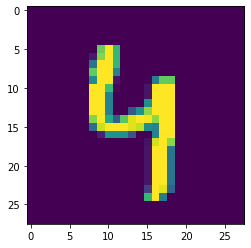

4
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3', '(', 'X', '4']


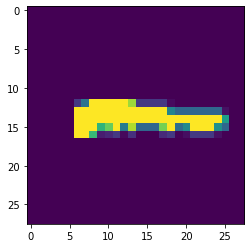

-
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3', '(', 'X', '4', '-']


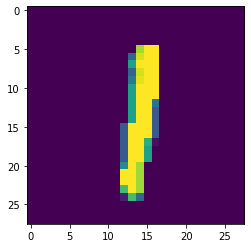

1
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3', '(', 'X', '4', '-', '1']


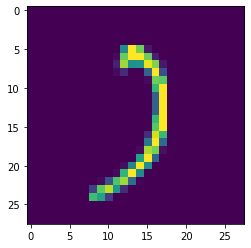

)
['-', '-', '7', '9', '2', '-', '1', ')', '(', 'X', '2', '+', '1', '3', '(', 'X', '4', '-', '1', ')']
RESULTANT
- - 7 9 2 - 1 ) ( X 2 + 1 3 ( X 4 - 1 )
ORIGINAL_SOLUTION
--(x2-1)(x2+1)(x4-1)


In [ ]:
solution_list = "--(x2-1)(x2+1)(x4-1)"
test_images = eq_words2[0]
predict_using_model(test_images,solution_list)



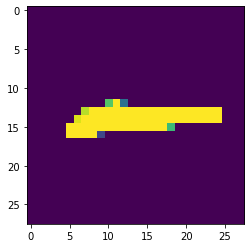

-
['-']


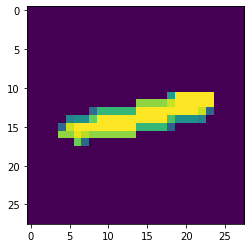

-
['-', '-']


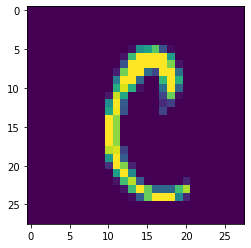

C
['-', '-', 'C']


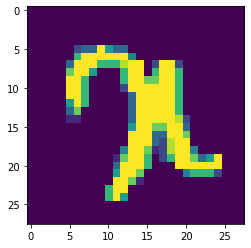

X
['-', '-', 'C', 'X']


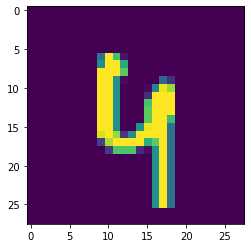

4
['-', '-', 'C', 'X', '4']


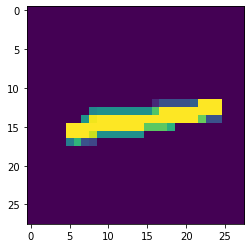

-
['-', '-', 'C', 'X', '4', '-']


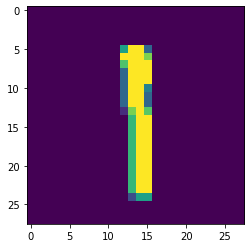

1
['-', '-', 'C', 'X', '4', '-', '1']


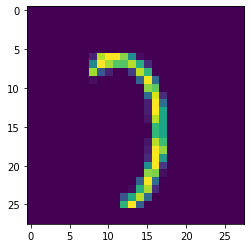

)
['-', '-', 'C', 'X', '4', '-', '1', ')']


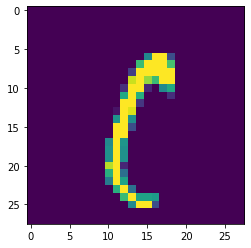

1
['-', '-', 'C', 'X', '4', '-', '1', ')', '1']


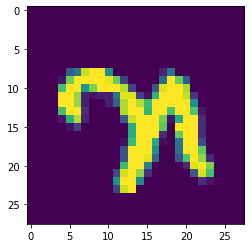

A
['-', '-', 'C', 'X', '4', '-', '1', ')', '1', 'A']


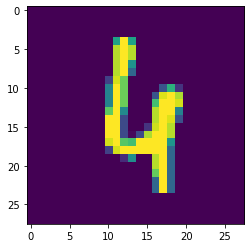

4
['-', '-', 'C', 'X', '4', '-', '1', ')', '1', 'A', '4']


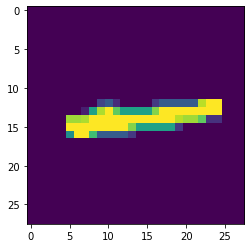

-
['-', '-', 'C', 'X', '4', '-', '1', ')', '1', 'A', '4', '-']


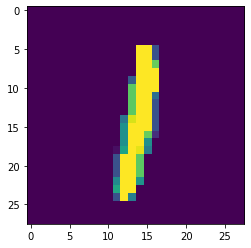

1
['-', '-', 'C', 'X', '4', '-', '1', ')', '1', 'A', '4', '-', '1']


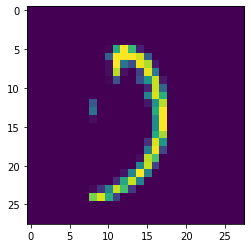

)
['-', '-', 'C', 'X', '4', '-', '1', ')', '1', 'A', '4', '-', '1', ')']
RESULTANT
- - C X 4 - 1 ) 1 A 4 - 1 )
ORIGINAL_SOLUTION
(x4-1)(x4-1)


In [ ]:
test_images = eq_words2[1]
solution_list = "(x4-1)(x4-1)"
predict_using_model(test_images,solution_list)

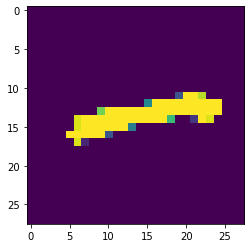

-
['-']


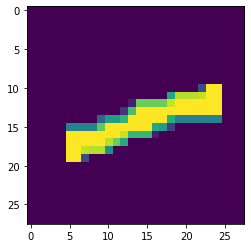

-
['-', '-']


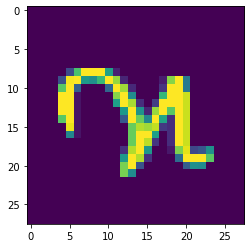

X
['-', '-', 'X']


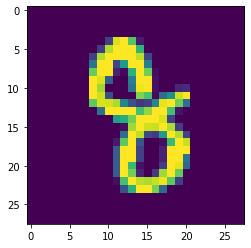

y
['-', '-', 'X', 'y']


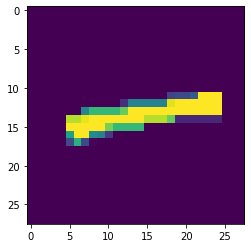

-
['-', '-', 'X', 'y', '-']


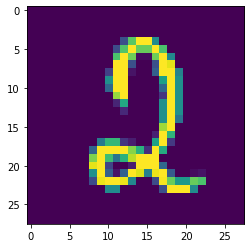

1
['-', '-', 'X', 'y', '-', '1']


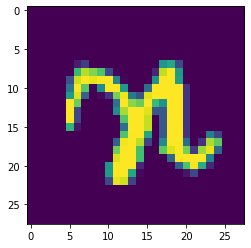

X
['-', '-', 'X', 'y', '-', '1', 'X']


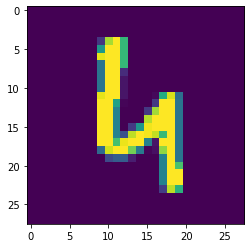

4
['-', '-', 'X', 'y', '-', '1', 'X', '4']


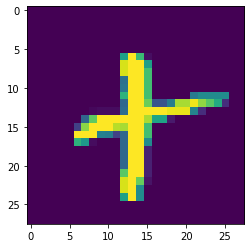

+
['-', '-', 'X', 'y', '-', '1', 'X', '4', '+']


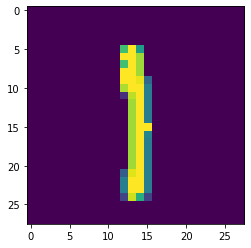

1
['-', '-', 'X', 'y', '-', '1', 'X', '4', '+', '1']
RESULTANT
- - X y - 1 X 4 + 1
ORIGINAL_SOLUTION
(x4-1)(x4-1)


In [ ]:
test_images = eq_words2[-1]
predict_using_model(test_images,solution_list)

################################################## MODEL 1 ********************************************************


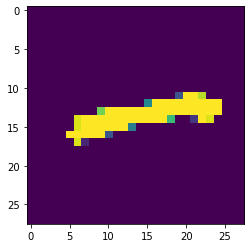

-
['-']


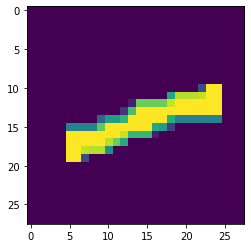

-
['-', '-']


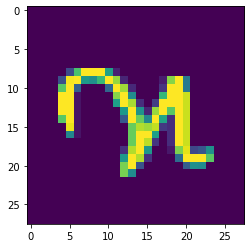

A
['-', '-', 'A']


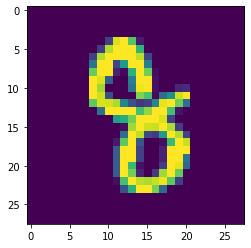

z
['-', '-', 'A', 'z']


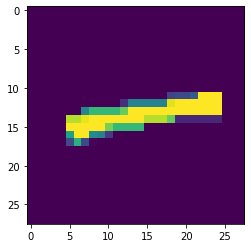

-
['-', '-', 'A', 'z', '-']


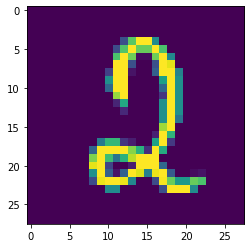

2
['-', '-', 'A', 'z', '-', '2']


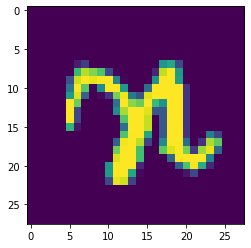

A
['-', '-', 'A', 'z', '-', '2', 'A']


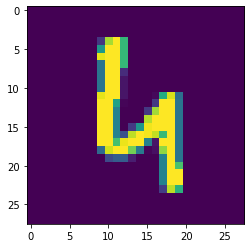

4
['-', '-', 'A', 'z', '-', '2', 'A', '4']


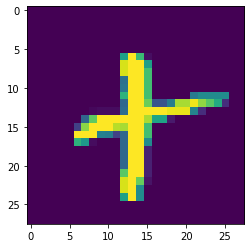

+
['-', '-', 'A', 'z', '-', '2', 'A', '4', '+']


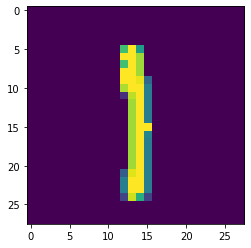

1
['-', '-', 'A', 'z', '-', '2', 'A', '4', '+', '1']
RESULTANT
- - A z - 2 A 4 + 1
ORIGINAL_SOLUTION
(x4-1)(x4-1)
################################################## MODEL 2 ********************************************************


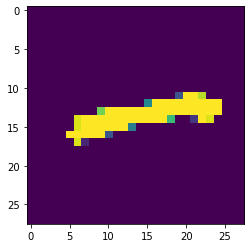

-
['-']


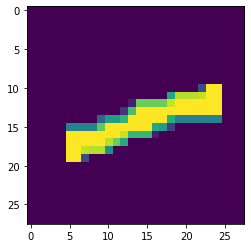

-
['-', '-']


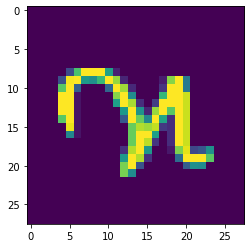

A
['-', '-', 'A']


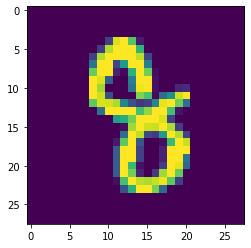

z
['-', '-', 'A', 'z']


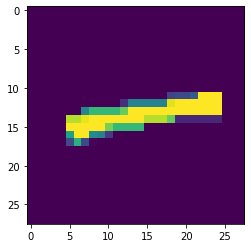

-
['-', '-', 'A', 'z', '-']


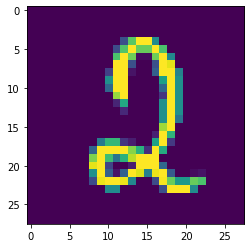

2
['-', '-', 'A', 'z', '-', '2']


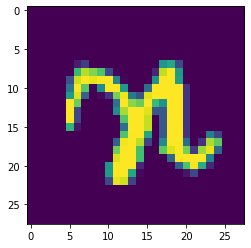

A
['-', '-', 'A', 'z', '-', '2', 'A']


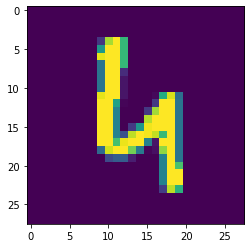

4
['-', '-', 'A', 'z', '-', '2', 'A', '4']


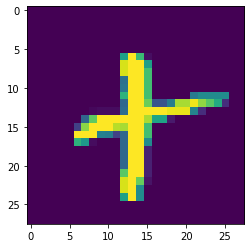

+
['-', '-', 'A', 'z', '-', '2', 'A', '4', '+']


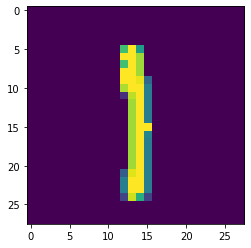

1
['-', '-', 'A', 'z', '-', '2', 'A', '4', '+', '1']
RESULTANT
- - A z - 2 A 4 + 1
ORIGINAL_SOLUTION
(x4-1)(x4-1)


In [ ]:
predict_using_model_1(test_images,solution_list)
predict_using_model_2(test_images,solution_list)